# COCO Dataset

In [1]:
import sys
sys.path.append('../../')

%load_ext autoreload
%autoreload 2

from dl.data.txtdetn import augmentations
from dl.data.txtdetn import datasets, target_transforms, transforms

In [2]:
augmentation = None

transform = transforms.Compose(
    [transforms.ToTensor(),
     #transforms.Normalize(rgb_means=(0.485, 0.456, 0.406), rgb_stds=(0.229, 0.224, 0.225))]
    ]
)
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.COCO2014Text_Dataset(ignore=target_transforms.Ignore(illegible=False), transform=transform, target_transform=target_transform, augmentation=None)


loading annotations into memory...
0:00:00.973551
creating index...
index created!


In [3]:
from dl.data.utils.boxes import centroids2corners
#from ssd.core.inference import toVisualizeRectangleRGBimg
from dl.data.utils.converter import toVisualizeQuadsRGBimg, toVisualizeRectRGBimg

%matplotlib notebook
import matplotlib.pyplot as plt
import numpy as np
import cv2, torch

# yellow rectangle is minimum bbox, red one is quadrilateral bbox

['apple', 'laptop', 'glaring', 'personal', 'differences']


<IPython.core.display.Javascript object>


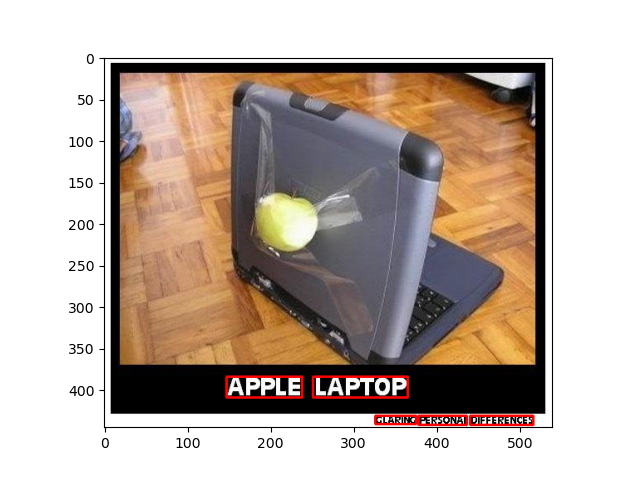

['', '', 'ce', '', '', '']


<IPython.core.display.Javascript object>


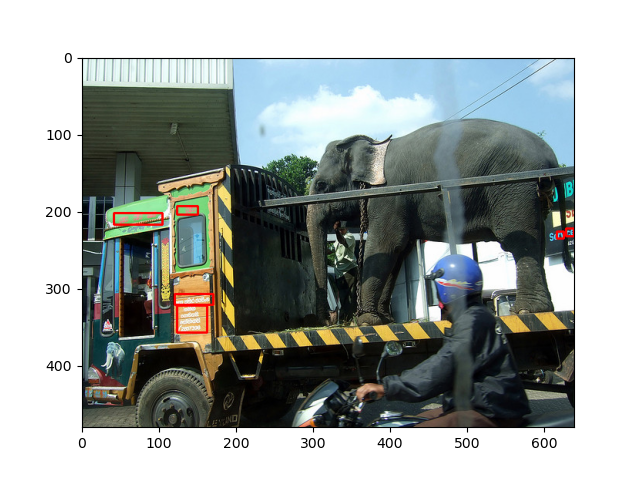

['Coca-Cola', 'ORKA', 'Nesti', 'Nesti']


<IPython.core.display.Javascript object>


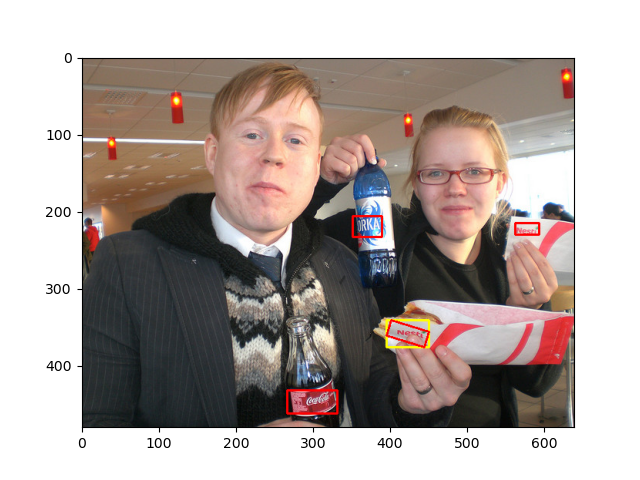

['', 'd', '', '', '3', '3', 'p', '1', '', '', 'high', 'large', 'recipe', 'medium', 'lemon', 'citrus', 'into', 'bowl', '', 'water', 'sugar', '', 'N', 'ee', '', '', 'cvs', 'sed.', '', 'minu', '', '', 'lace', 'this', 'on', 'be', '2', 'es', '5', 'in', 'jam', 'type', 'stir', 'fruit', 'vary', '18', 'will', 'minutes', 'sugar', 'about', 'during', 'stand', 'when', 'quarter', 'lemons', 'orange', 'cups', 'into', '1/2', '1', 'or', 'lemons', 'teste', 'finely', 'times', 'minutes', 'saucer', 'lemons,', 'cooking', '', 'in', 'times', '', '', 'before', 'minutes', 'cook', 'cold', 'pouring', 'sterilised', 'stir', 'deep', 'seal', 'citrus', 'used.', 'hot', 'of', 'es', 'is', 'the', 'for', '10', 'will', 'vary', 'to', 'er.', 'the', 'on', 'occasionally', 'on', 'cooking', 'PROCESSOR', 'any', 'dish', 'tomato', 'fruit', 'fruits', 'citrus', 'with', 'rind', 'tender.', 'cups', 'cups', 'processor', 'substituted ', 'combination', 'makes', 'depending', 'small', 'water', 'efore', 'place', 'seeds.', 'high', 'blend', 'unti

<IPython.core.display.Javascript object>


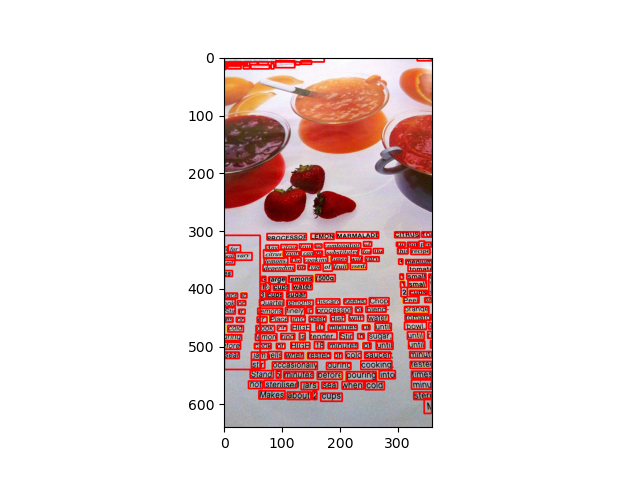

['f', 'on', 'on', 'f', 'f', 'f', '', '', '', 'course', 'course', 'concourse', 'domestic', 'baggage', '']


<IPython.core.display.Javascript object>


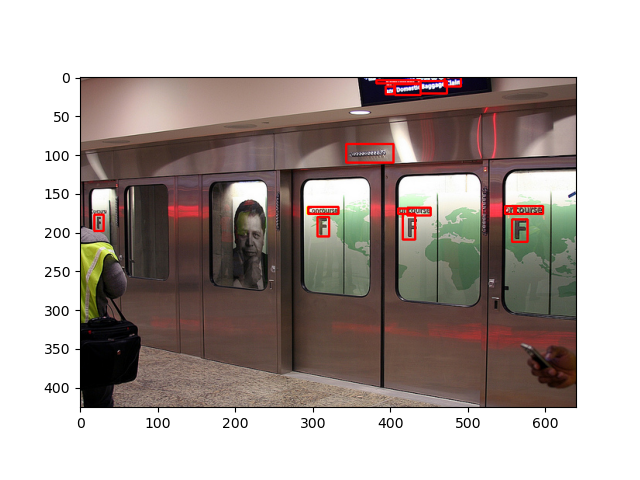

['', '', 'newz', 'air', '', '', '', '', 'EALAND', '']


<IPython.core.display.Javascript object>


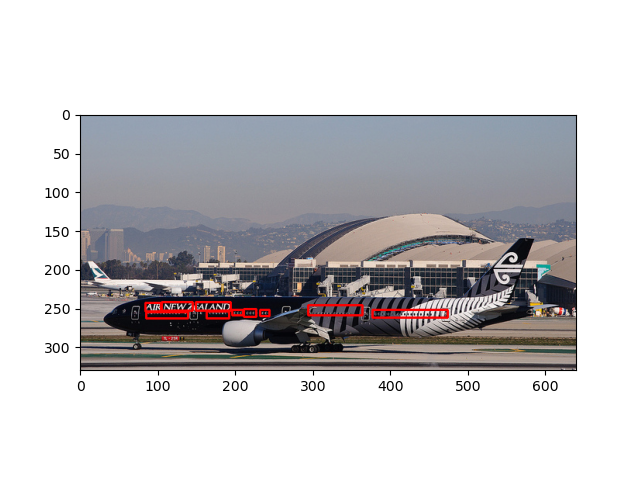

['F-PRPR']


<IPython.core.display.Javascript object>


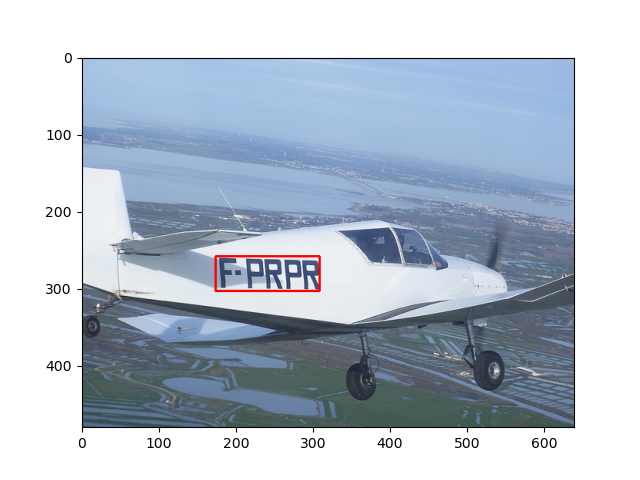

['', '', '93', '', '', '86', '', '131', '', '25']


<IPython.core.display.Javascript object>


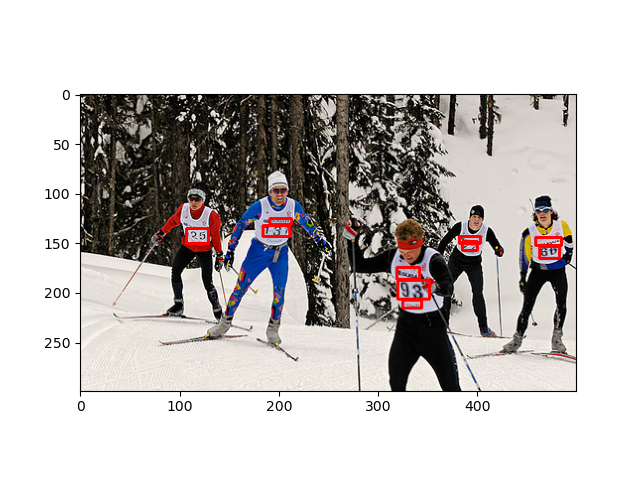

['coin', '0', 'coin', 'coin', 'coin']


<IPython.core.display.Javascript object>


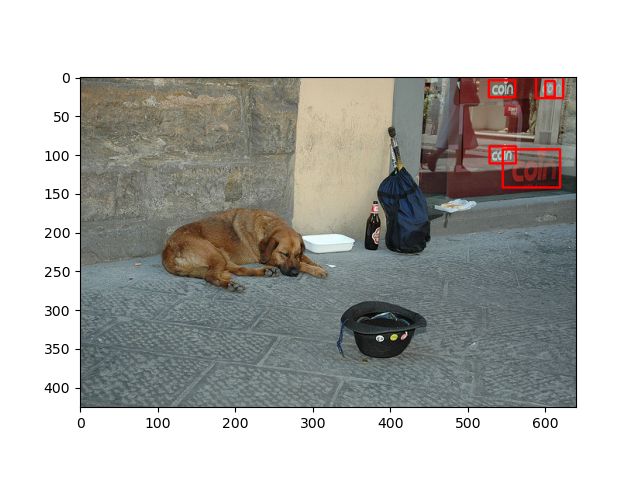

['', '', 'the', '232-', '356,', 'ranch', 'a', 'c', 'b', '160', '', '11', '']


<IPython.core.display.Javascript object>


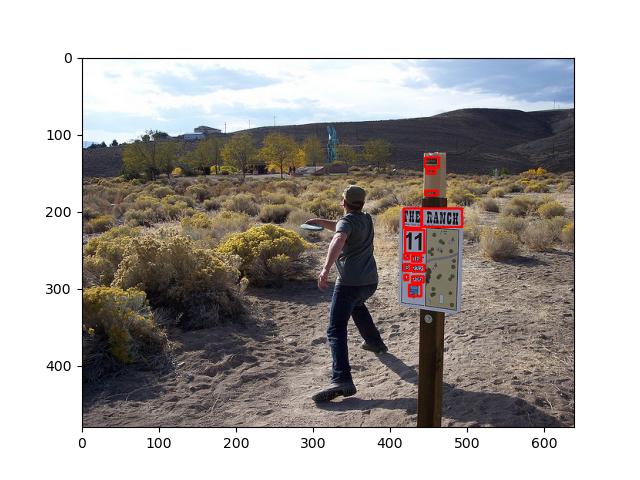

['CONSERVATION', 'WILDLIFE', '3922', 'alert', 'rescue', 'fwc', '888-404-fwcc', 'wildlife', 'HOTLINE:', '', 'FLORIDA', 'FISH', 'COMMISSION', 'AND', 'MANATEE']


<IPython.core.display.Javascript object>


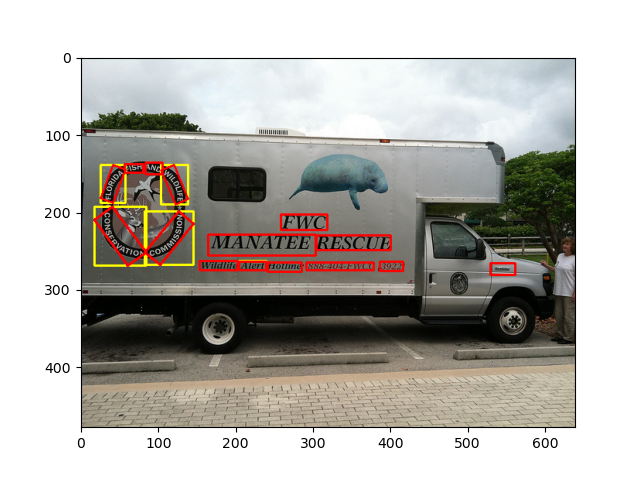

['Hwave']


<IPython.core.display.Javascript object>


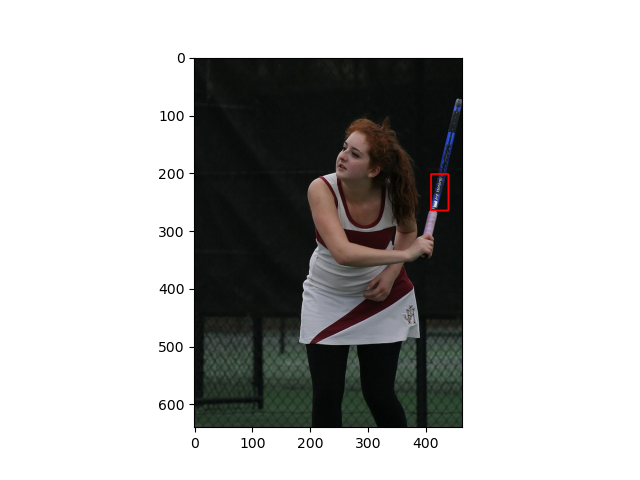

['Color']


<IPython.core.display.Javascript object>


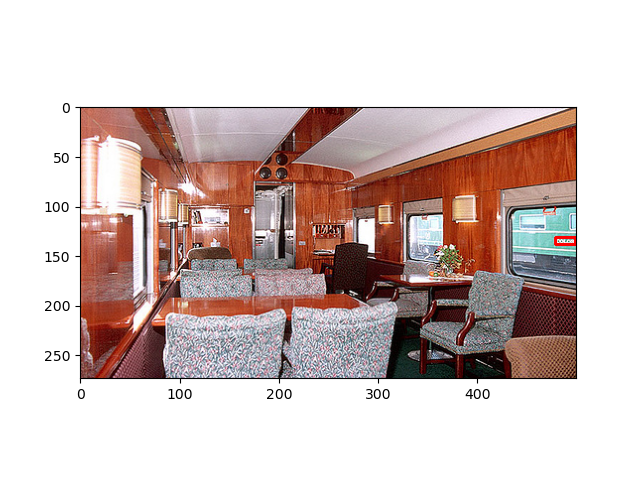

['SMA', '']


<IPython.core.display.Javascript object>


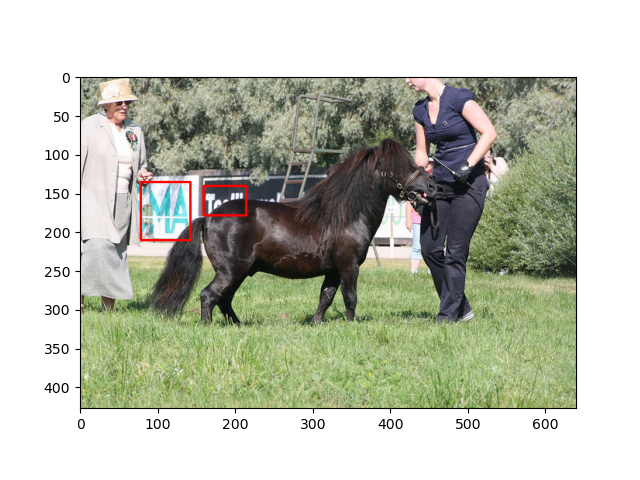

['F']


<IPython.core.display.Javascript object>


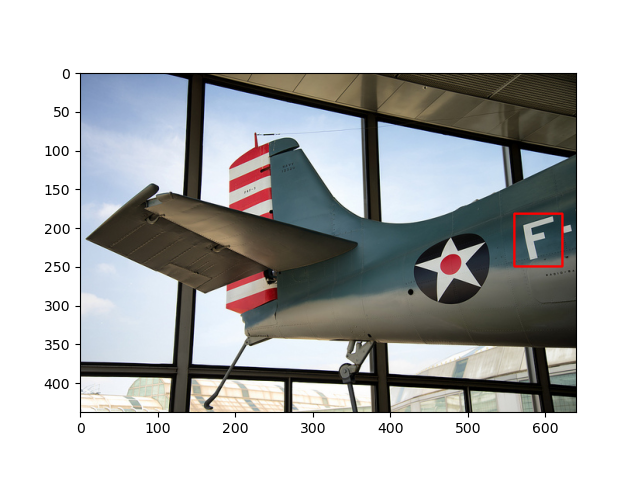

In [4]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# SynthText

In [5]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.SynthTextDetectionDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['Now,', 'use', 'the', 'Now', 'the', 'than', 'New', 'Lee', 'same.', 'Cold']
tensor([[0.6792, 0.4583, 0.0842, 0.0635],
        [0.6622, 0.5267, 0.0454, 0.0319],
        [0.2256, 0.7532, 0.1771, 0.1613],
        [0.9440, 0.1995, 0.1099, 0.1184],
        [0.5276, 0.2463, 0.0654, 0.0523],
        [0.7931, 0.6587, 0.2495, 0.1449],
        [0.5346, 0.4329, 0.0417, 0.0391],
        [0.5158, 0.5032, 0.0316, 0.0533],
        [0.2238, 0.8144, 0.1053, 0.0763],
        [0.3350, 0.7537, 0.0851, 0.0749]])


<IPython.core.display.Javascript object>


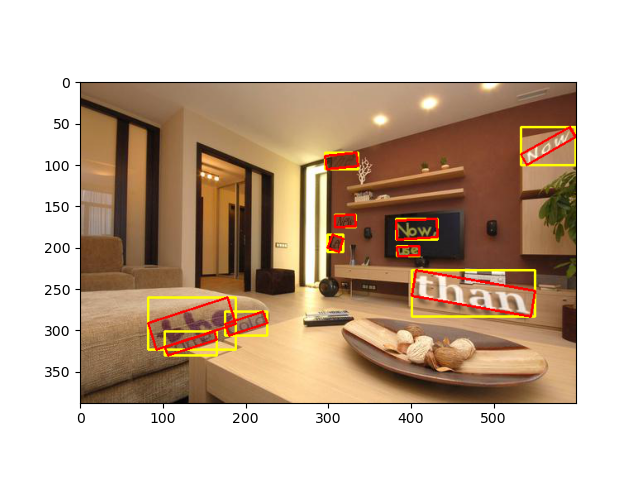

['Lines:', '25', 'Apr', '93', 'Lines:', 'Mac', 'you', 'follow']
tensor([[0.8888, 0.0652, 0.0890, 0.0982],
        [0.9751, 0.0601, 0.0380, 0.0849],
        [0.1869, 0.3063, 0.0940, 0.0812],
        [0.2851, 0.3226, 0.0502, 0.0562],
        [0.2090, 0.3907, 0.1250, 0.0696],
        [0.4643, 0.7440, 0.1562, 0.1812],
        [0.4710, 0.0541, 0.0636, 0.0543],
        [0.5570, 0.0384, 0.0859, 0.0505]])


<IPython.core.display.Javascript object>


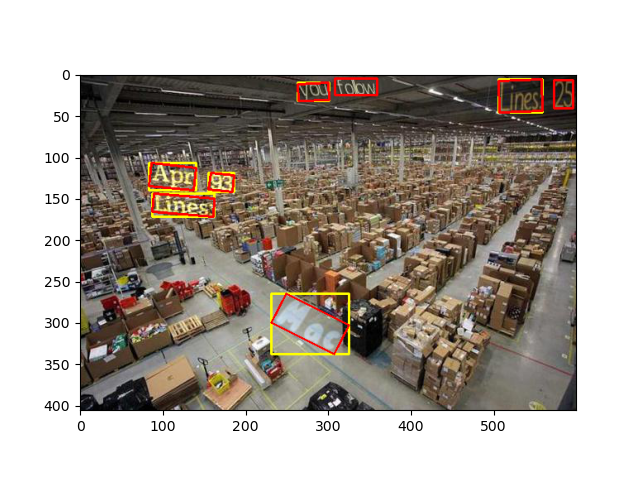

['does', 'few', 'For', 'a', '5380,', 'lock', 'whiz']
tensor([[0.4198, 0.4330, 0.1240, 0.0573],
        [0.0858, 0.0355, 0.0714, 0.0582],
        [0.0844, 0.1099, 0.0676, 0.0566],
        [0.1486, 0.1216, 0.0216, 0.0398],
        [0.3000, 0.0412, 0.1135, 0.0510],
        [0.4331, 0.4933, 0.0867, 0.0489],
        [0.0878, 0.1912, 0.1452, 0.1177]])


<IPython.core.display.Javascript object>


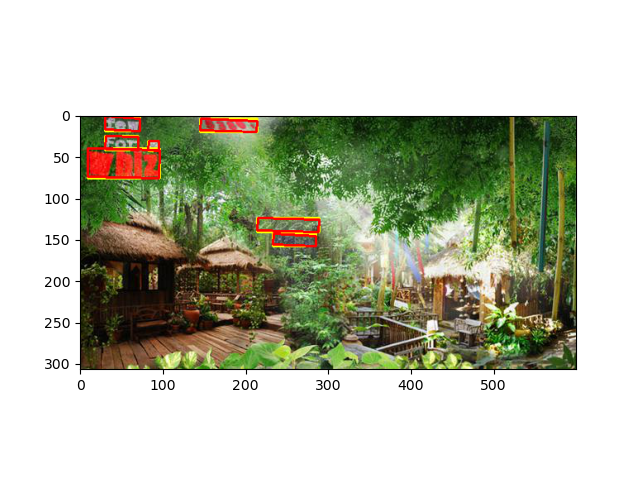

['Hi,', 'From:', 'From:', 'Date:', 'OPS']
tensor([[0.1937, 0.7355, 0.1263, 0.1201],
        [0.4005, 0.1716, 0.3638, 0.3591],
        [0.3076, 0.7096, 0.1002, 0.0688],
        [0.2459, 0.4649, 0.2505, 0.2460],
        [0.3694, 0.6386, 0.0818, 0.0638]])


<IPython.core.display.Javascript object>


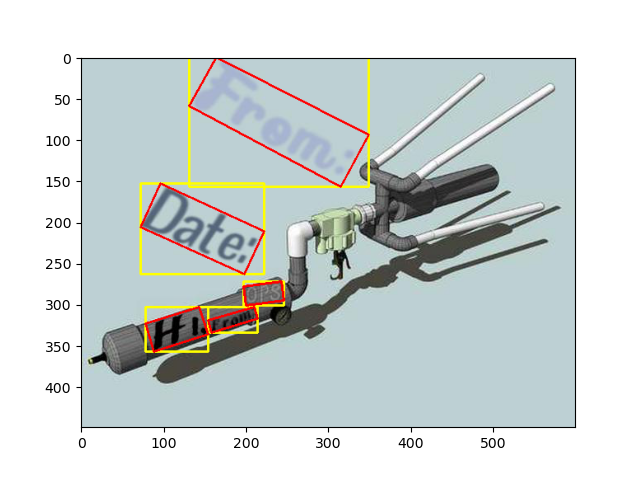

['Tek', 'From:', 'you', '386']
tensor([[0.9009, 0.9521, 0.1175, 0.0789],
        [0.9072, 0.1197, 0.1209, 0.0823],
        [0.9582, 0.0833, 0.0847, 0.0709],
        [0.7909, 0.0374, 0.0533, 0.0439]])


<IPython.core.display.Javascript object>


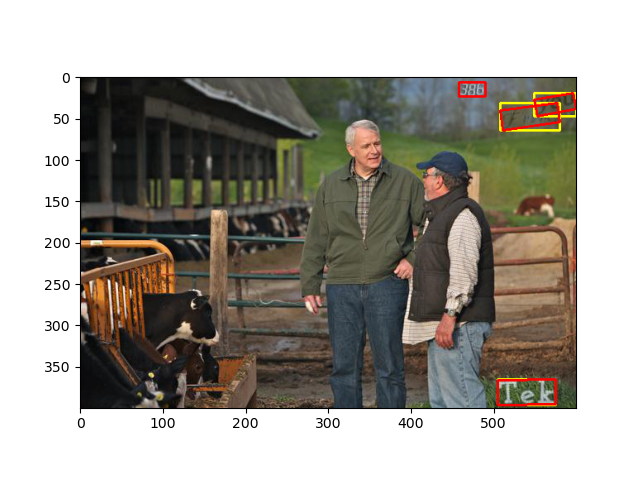

['all', 'type', 'I', 'like', 'HIV']
tensor([[0.3505, 0.5468, 0.0668, 0.0933],
        [0.4928, 0.4847, 0.1868, 0.1636],
        [0.0732, 0.7942, 0.0163, 0.0919],
        [0.1546, 0.8819, 0.1387, 0.1846],
        [0.3496, 0.6066, 0.1085, 0.1461]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


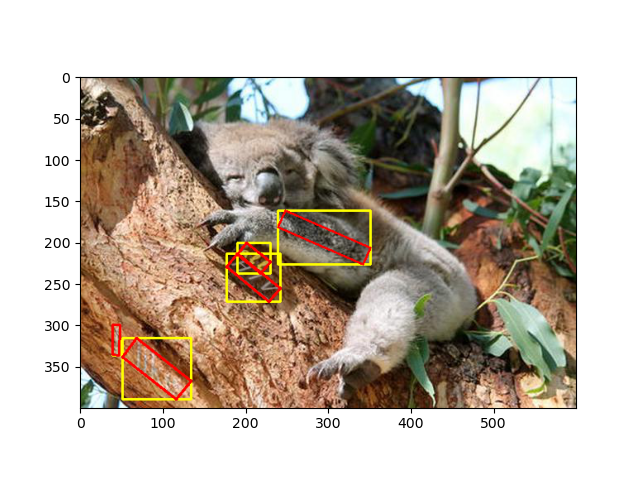

['Lines:', 'another', 'sell', 'at', 'cases', 'in', 'Apr']
tensor([[0.0724, 0.8742, 0.1839, 0.2434],
        [0.7611, 0.1992, 0.2296, 0.0627],
        [0.7109, 0.2793, 0.1003, 0.0669],
        [0.8305, 0.2734, 0.0592, 0.0607],
        [0.7637, 0.3605, 0.1669, 0.0571],
        [0.9078, 0.3387, 0.0620, 0.0719],
        [0.5931, 0.6158, 0.7466, 0.5377]])


<IPython.core.display.Javascript object>


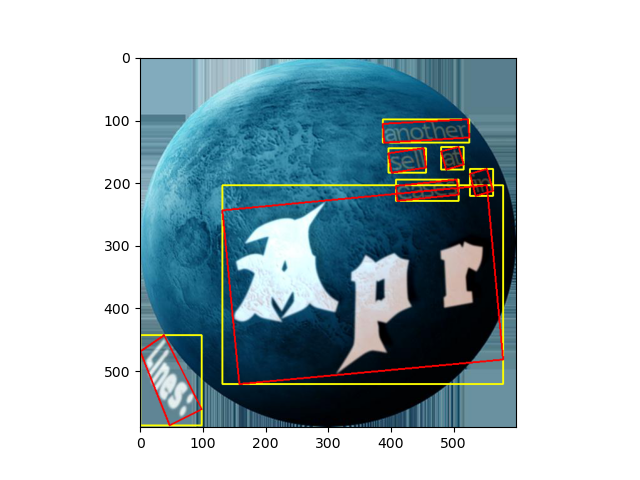

['>is', 'The', '>in']
tensor([[0.7022, 0.2106, 0.3147, 0.2330],
        [0.2154, 0.9761, 0.0791, 0.0288],
        [0.4318, 0.1295, 0.2768, 0.2157]])


<IPython.core.display.Javascript object>


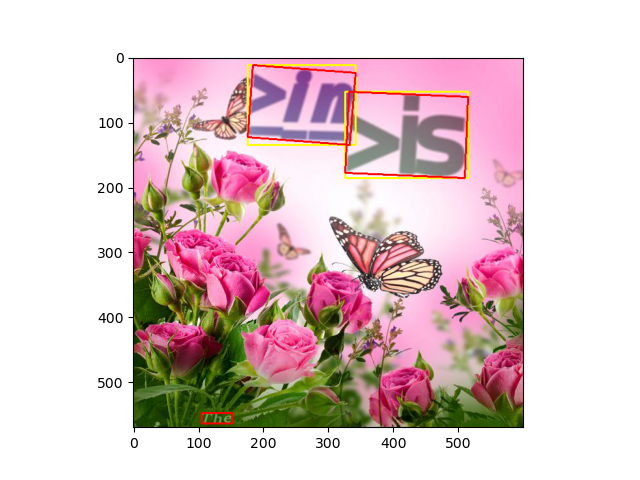

['that', "it's", 'THE', 'THE']
tensor([[0.5468, 0.5416, 0.0726, 0.0686],
        [0.9553, 0.4296, 0.0776, 0.1230],
        [0.8037, 0.0712, 0.0850, 0.1313],
        [0.8475, 0.1215, 0.0930, 0.1417]])


<IPython.core.display.Javascript object>


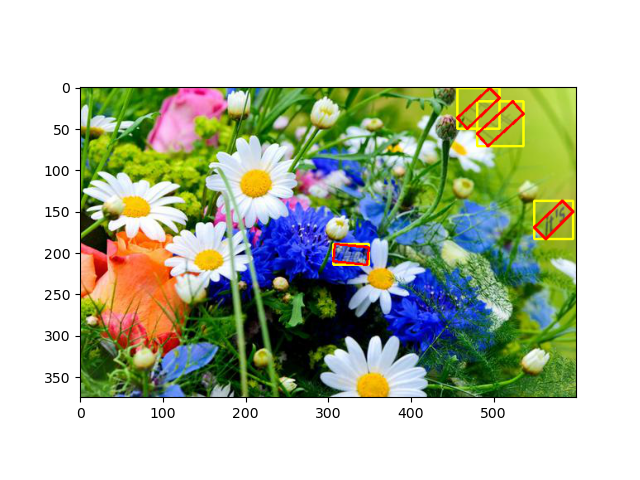

['the', '61', '3', 'the', '2-2']
tensor([[0.5233, 0.2544, 0.0767, 0.0547],
        [0.3654, 0.2003, 0.0568, 0.0881],
        [0.4195, 0.2685, 0.0422, 0.0720],
        [0.4488, 0.1894, 0.0691, 0.1029],
        [0.9399, 0.5567, 0.1215, 0.1796]])


<IPython.core.display.Javascript object>


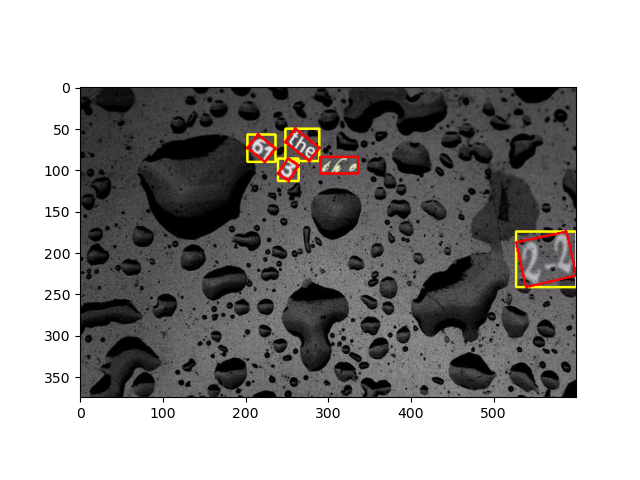

["I'm", 'Galaga', 'Many']
tensor([[0.4516, 0.5647, 0.0648, 0.0734],
        [0.3863, 0.1383, 0.5879, 0.2728],
        [0.4183, 0.4861, 0.1095, 0.1091]])


<IPython.core.display.Javascript object>


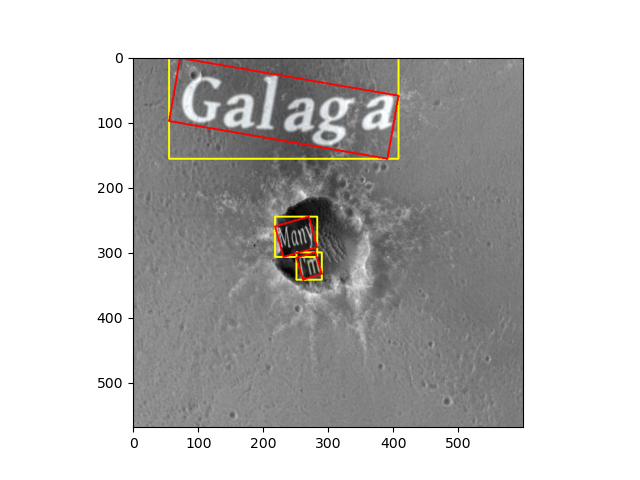

['Date:', 'State', 'Big', 'Her', 'its', 'a', 're-boost', 'of', 'cell', 'two', 'that', 'a', 'hole', 'in', 'the', 'the', 'device', 'from', 'out', 'was', 'The', 'on', 'a', 'the']
tensor([[0.4078, 0.3587, 0.1026, 0.0369],
        [0.4154, 0.3993, 0.1128, 0.0412],
        [0.0648, 0.4131, 0.1127, 0.0958],
        [0.7193, 0.7794, 0.2776, 0.2120],
        [0.8459, 0.5603, 0.1944, 0.0826],
        [0.6758, 0.1669, 0.0152, 0.0261],
        [0.7534, 0.1628, 0.1031, 0.0359],
        [0.8377, 0.1634, 0.0318, 0.0359],
        [0.7931, 0.3514, 0.0788, 0.0526],
        [0.7874, 0.3956, 0.0752, 0.0525],
        [0.7927, 0.4466, 0.0873, 0.0581],
        [0.0770, 0.8456, 0.0214, 0.0358],
        [0.1319, 0.8596, 0.0631, 0.0578],
        [0.1946, 0.8845, 0.0311, 0.0470],
        [0.2521, 0.9019, 0.0587, 0.0577],
        [0.0492, 0.8925, 0.0552, 0.0566],
        [0.1369, 0.9282, 0.0966, 0.0788],
        [0.2395, 0.9641, 0.0773, 0.0673],
        [0.2872, 0.3904, 0.1275, 0.0462],
        [0.9181, 0.7923, 0

<IPython.core.display.Javascript object>


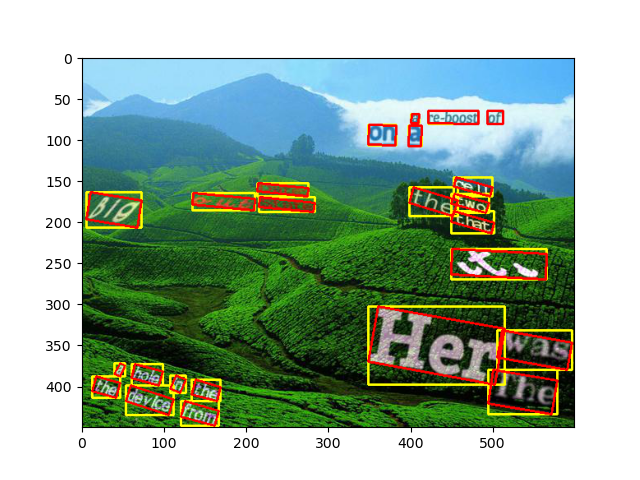

['.738', '.737', '.713', '.709', '.681', 'seen', 'the', 'that', 'they', 'may', 'that', 'card.', "you're", 'have', 'series', 'this', 'the']
tensor([[0.7391, 0.2349, 0.1152, 0.0950],
        [0.7489, 0.3131, 0.1129, 0.0927],
        [0.7548, 0.3915, 0.1029, 0.0857],
        [0.7710, 0.4669, 0.1137, 0.0890],
        [0.7752, 0.5454, 0.1007, 0.0818],
        [0.5537, 0.1495, 0.0974, 0.0595],
        [0.1921, 0.6511, 0.0826, 0.0772],
        [0.1954, 0.7416, 0.0972, 0.0767],
        [0.1922, 0.8270, 0.1030, 0.0948],
        [0.1869, 0.9078, 0.0920, 0.0656],
        [0.1788, 0.9645, 0.0849, 0.0601],
        [0.6695, 0.0841, 0.0876, 0.0912],
        [0.6957, 0.1917, 0.1110, 0.1232],
        [0.3011, 0.9227, 0.1181, 0.1075],
        [0.5694, 0.2403, 0.1268, 0.0853],
        [0.5652, 0.3249, 0.0910, 0.0818],
        [0.5742, 0.4179, 0.0763, 0.0804]])


<IPython.core.display.Javascript object>


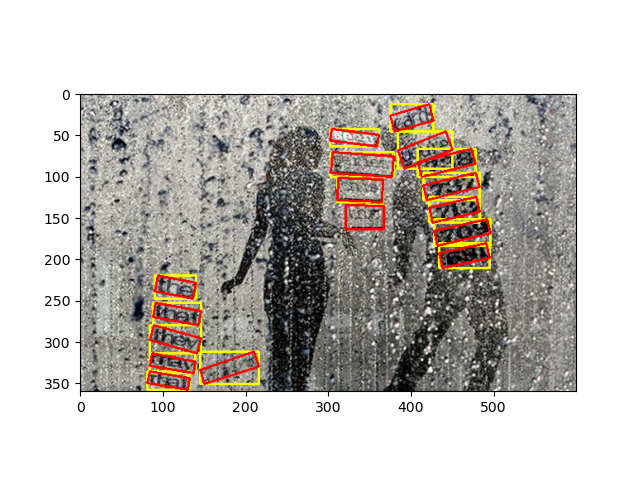

['Subject:', 'Re:', 'Date:', '28', 'Apr', 'San', 'Lines:', '20', 'Newsgroups:', 'sci.crypt']
tensor([[0.3531, 0.2044, 0.3863, 0.1337],
        [0.6919, 0.2000, 0.1440, 0.1070],
        [0.2671, 0.3375, 0.2289, 0.1118],
        [0.5068, 0.3434, 0.1214, 0.1113],
        [0.7276, 0.3639, 0.1926, 0.1434],
        [0.5146, 0.4968, 0.1792, 0.1191],
        [0.3408, 0.6462, 0.2814, 0.1325],
        [0.6169, 0.6711, 0.1330, 0.1108],
        [0.2426, 0.9371, 0.2989, 0.1071],
        [0.5313, 0.9549, 0.2152, 0.0944]])


<IPython.core.display.Javascript object>


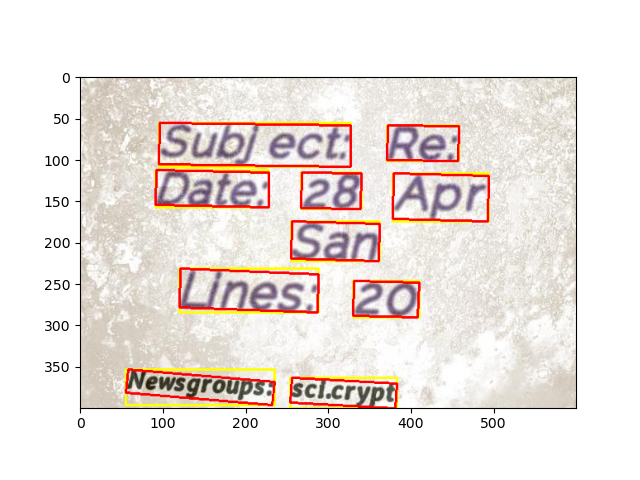

['the', 'San', 'got', 'Apr', 'the', 'have']
tensor([[0.1142, 0.1336, 0.1837, 0.1737],
        [0.1252, 0.2889, 0.1934, 0.1480],
        [0.0429, 0.5520, 0.0737, 0.0694],
        [0.1870, 0.4627, 0.1064, 0.0560],
        [0.0325, 0.3397, 0.0735, 0.0535],
        [0.0445, 0.3996, 0.0868, 0.0527]])


<IPython.core.display.Javascript object>


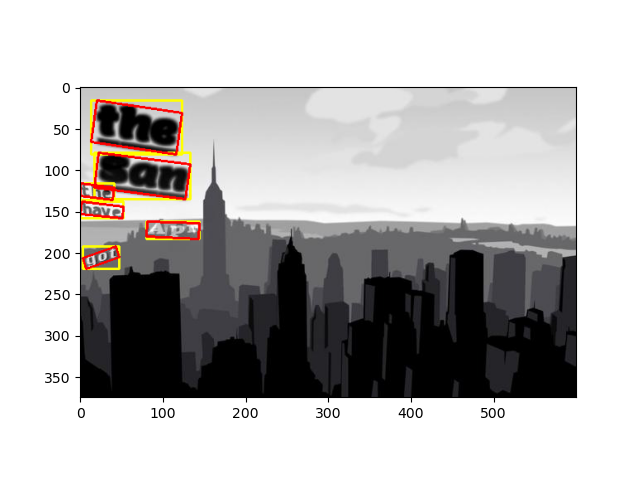

In [6]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# ICDAR2015

In [7]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDAR2015TextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['###', '###', 'Massage', 'Acupuncture', 'Massotherapy', '###', '###', 'Body', 'Massage']
tensor([[0.4105, 0.1049, 0.0461, 0.0681],
        [0.4406, 0.0792, 0.0250, 0.0556],
        [0.4988, 0.0507, 0.0961, 0.0931],
        [0.5168, 0.2944, 0.1195, 0.0722],
        [0.5230, 0.3757, 0.1305, 0.0569],
        [0.4500, 0.4444, 0.0391, 0.0444],
        [0.4812, 0.4465, 0.0172, 0.0458],
        [0.5207, 0.4493, 0.0492, 0.0597],
        [0.6055, 0.4563, 0.1063, 0.0792]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


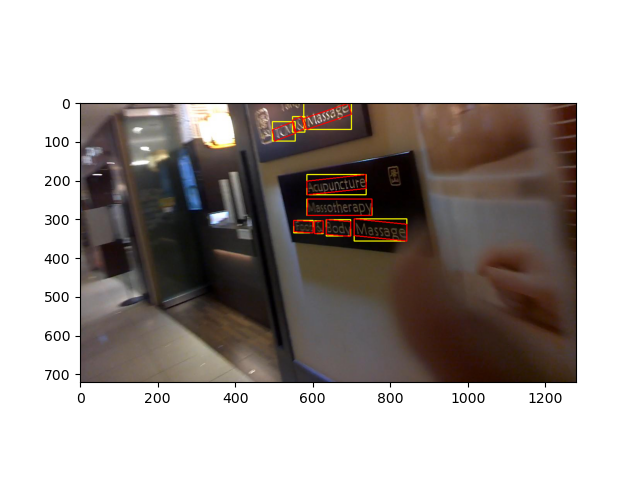

['B05', '154', 'Ave', 'Clementi', '17059', '###', '###', '188', '196', '201', '727', '963', '963R']
tensor([[0.5426, 0.0688, 0.0289, 0.0347],
        [0.2277, 0.0785, 0.0180, 0.0208],
        [0.4582, 0.1042, 0.0273, 0.0333],
        [0.4164, 0.1215, 0.0578, 0.0458],
        [0.2477, 0.0090, 0.0297, 0.0181],
        [0.4793, 0.0944, 0.0148, 0.0278],
        [0.2473, 0.0285, 0.0352, 0.0208],
        [0.2492, 0.0743, 0.0172, 0.0208],
        [0.2707, 0.0715, 0.0180, 0.0208],
        [0.2285, 0.0986, 0.0180, 0.0222],
        [0.2488, 0.0951, 0.0180, 0.0208],
        [0.2703, 0.0917, 0.0172, 0.0194],
        [0.3082, 0.0667, 0.0211, 0.0194]])


<IPython.core.display.Javascript object>


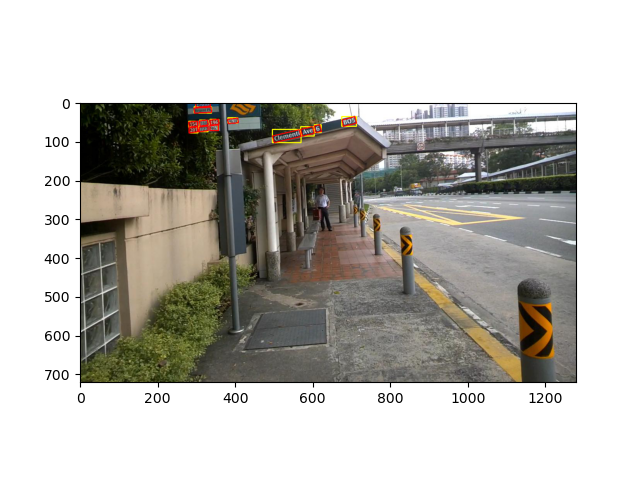

['motherswork', '###', 'minds', 'DISCOVER', 'MORE', '###', '###', '###', 'notherswork']
tensor([[0.8285, 0.3111, 0.1305, 0.0583],
        [0.9203, 0.2785, 0.0406, 0.0292],
        [0.9211, 0.2979, 0.0391, 0.0264],
        [0.7031, 0.1465, 0.0812, 0.0542],
        [0.7660, 0.1292, 0.0508, 0.0500],
        [0.4516, 0.1063, 0.0828, 0.1986],
        [0.4277, 0.7965, 0.0789, 0.1486],
        [0.5980, 0.2958, 0.0352, 0.0667],
        [0.3906, 0.3785, 0.1016, 0.0347]])


<IPython.core.display.Javascript object>


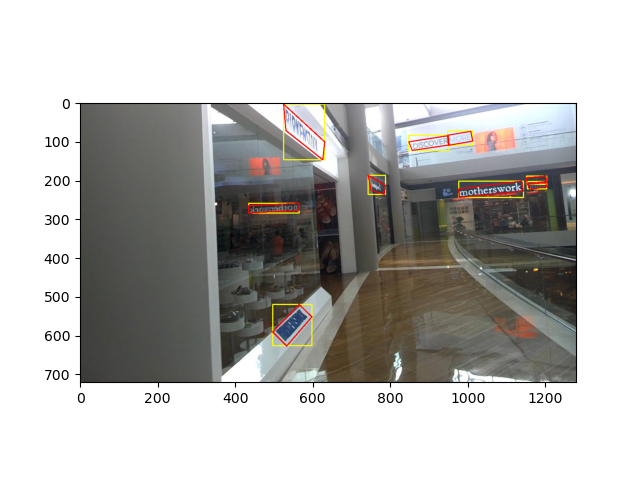

['TERMINAL', 'PRADA', 'CASINO', 'HOTEL', '###', 'PRADA', 'COACH', 'PRADA', 'BVLGA', '###', '###', '###', '###', '###', '###']
tensor([[0.4102, 0.4083, 0.0406, 0.0222],
        [0.5973, 0.3958, 0.0492, 0.0556],
        [0.3816, 0.3438, 0.0273, 0.0181],
        [0.3777, 0.3743, 0.0242, 0.0181],
        [0.4152, 0.3778, 0.0352, 0.0167],
        [0.2133, 0.3368, 0.0781, 0.0486],
        [0.3766, 0.4042, 0.0281, 0.0167],
        [0.0449, 0.3181, 0.0695, 0.0500],
        [0.9715, 0.5326, 0.0383, 0.0264],
        [0.8887, 0.5354, 0.0258, 0.0125],
        [0.7445, 0.7576, 0.0203, 0.0292],
        [0.7441, 0.7868, 0.0180, 0.0236],
        [0.7469, 0.8111, 0.0188, 0.0278],
        [0.7172, 0.8708, 0.0422, 0.0222],
        [0.7465, 0.8743, 0.0195, 0.0208]])


<IPython.core.display.Javascript object>


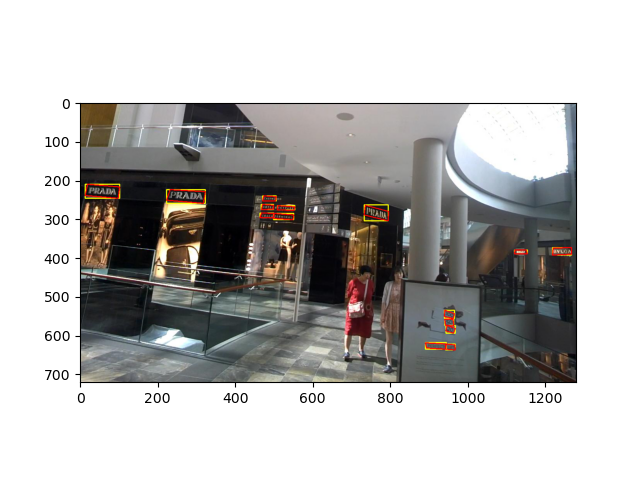

['###', 'Back', '###', 'School', 'SALES', '###', '###']
tensor([[0.3273, 0.3500, 0.0109, 0.0167],
        [0.5031, 0.3660, 0.0203, 0.0181],
        [0.5184, 0.3660, 0.0117, 0.0181],
        [0.5395, 0.3660, 0.0305, 0.0208],
        [0.5227, 0.3951, 0.0656, 0.0403],
        [0.2637, 0.2701, 0.0289, 0.0153],
        [0.3293, 0.2222, 0.0695, 0.0667]])


<IPython.core.display.Javascript object>


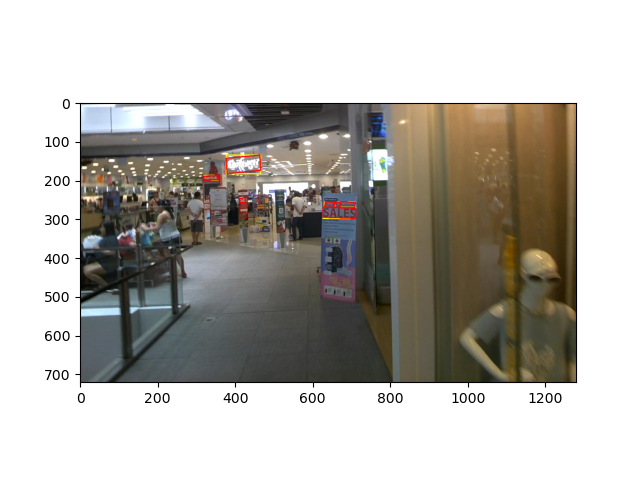

['CUSTOM', 'YOURS', '###', 'MAKE', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.4004, 0.1257, 0.0445, 0.0375],
        [0.3367, 0.1354, 0.0547, 0.0486],
        [0.9824, 0.0938, 0.0195, 0.0264],
        [0.2711, 0.1604, 0.0391, 0.0431],
        [0.3023, 0.1465, 0.0172, 0.0347],
        [0.9180, 0.1139, 0.0109, 0.0194],
        [0.9016, 0.1167, 0.0250, 0.0250],
        [0.3113, 0.2965, 0.0570, 0.0264],
        [0.4563, 0.2528, 0.0344, 0.0250],
        [0.7430, 0.2750, 0.0312, 0.0250],
        [0.8211, 0.2646, 0.0203, 0.0208],
        [0.9340, 0.2354, 0.0820, 0.0431]])


<IPython.core.display.Javascript object>


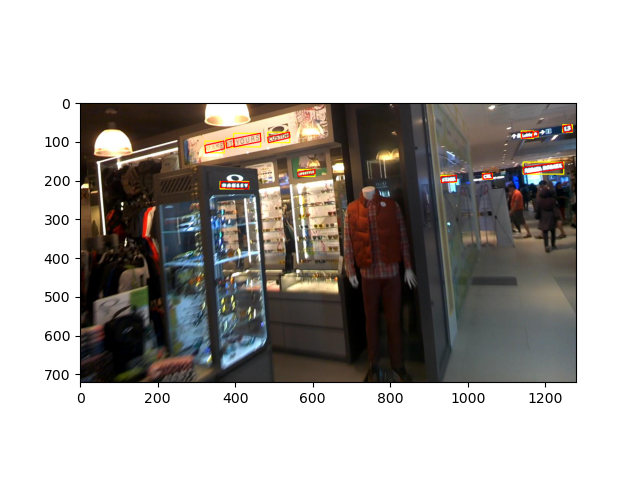

['MOLESKINE', 'MOLESKINE', '###', '###']
tensor([[0.8293, 0.2257, 0.3383, 0.2347],
        [0.8609, 0.3875, 0.1047, 0.0611],
        [0.0535, 0.5347, 0.0602, 0.0556],
        [0.6855, 0.4139, 0.0539, 0.0333]])


<IPython.core.display.Javascript object>


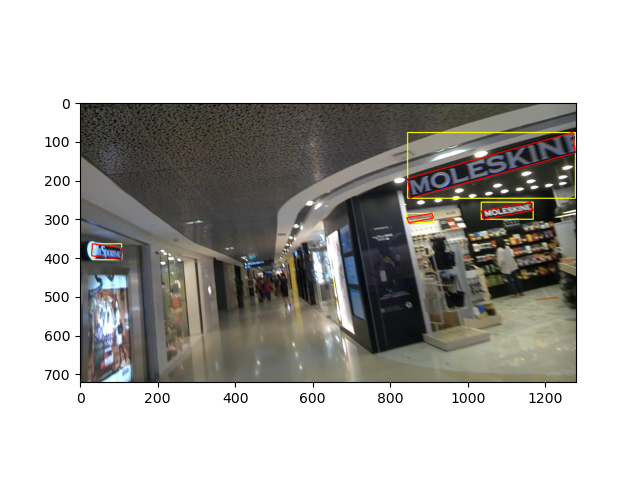

['TOPMAN', 'FURTHER', 'REDUCTION', '###', '###', 'off', '###', '###', '70%', '###']
tensor([[0.6113, 0.4875, 0.0711, 0.0333],
        [0.5789, 0.4160, 0.0484, 0.0681],
        [0.6293, 0.3681, 0.0648, 0.0833],
        [0.5926, 0.2667, 0.0695, 0.0861],
        [0.6414, 0.2403, 0.0312, 0.0444],
        [0.6418, 0.2806, 0.0289, 0.0361],
        [0.5656, 0.2167, 0.0234, 0.0250],
        [0.5836, 0.2125, 0.0203, 0.0306],
        [0.4477, 0.2201, 0.0500, 0.1042],
        [0.4559, 0.3597, 0.0414, 0.0528]])


<IPython.core.display.Javascript object>


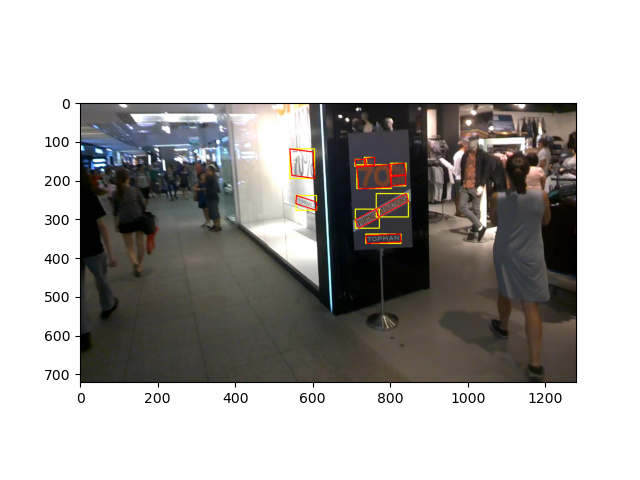

['CITYLINK', '###', '###']
tensor([[0.7652, 0.3479, 0.0477, 0.0319],
        [0.2887, 0.4056, 0.0211, 0.0278],
        [0.0750, 0.5188, 0.0328, 0.0958]])


<IPython.core.display.Javascript object>


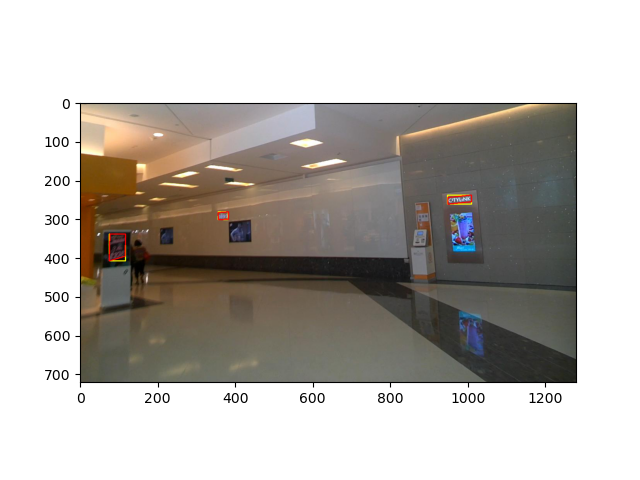

['###', '###', '###', '###', '###']
tensor([[0.1652, 0.6750, 0.0367, 0.1083],
        [0.2191, 0.6389, 0.0398, 0.0972],
        [0.2703, 0.6083, 0.0359, 0.0861],
        [0.3746, 0.5854, 0.0977, 0.1181],
        [0.6676, 0.1521, 0.0305, 0.0625]])


<IPython.core.display.Javascript object>


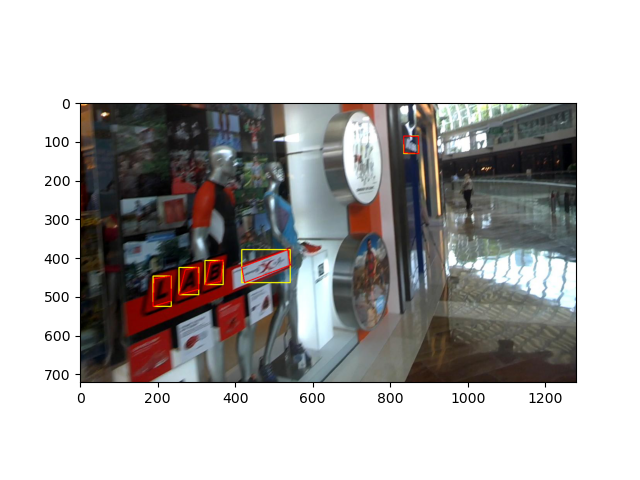

['###', '###', '###', '###', 'cool', 'merci', '###', 'merci', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.1184, 0.6243, 0.0445, 0.0458],
        [0.2484, 0.5139, 0.0250, 0.0417],
        [0.4613, 0.6451, 0.0383, 0.0486],
        [0.4863, 0.6326, 0.0164, 0.0319],
        [0.5055, 0.6104, 0.0344, 0.0542],
        [0.7668, 0.6389, 0.0758, 0.0639],
        [0.8922, 0.6083, 0.0875, 0.0750],
        [0.6242, 0.7201, 0.1203, 0.0986],
        [0.4004, 0.7972, 0.0336, 0.0389],
        [0.3988, 0.8694, 0.0352, 0.0361],
        [0.1645, 0.2139, 0.0477, 0.0556],
        [0.2566, 0.1847, 0.0430, 0.0389],
        [0.5805, 0.1271, 0.0359, 0.0458],
        [0.9738, 0.2299, 0.0414, 0.0653],
        [0.9664, 0.1847, 0.0250, 0.0389],
        [0.9156, 0.2410, 0.0

<IPython.core.display.Javascript object>


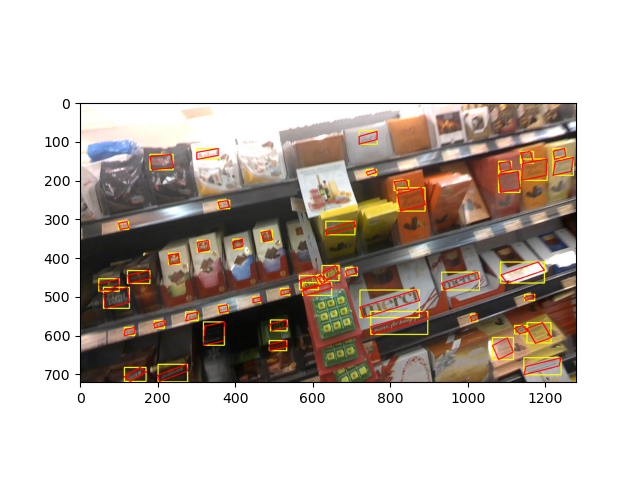

['SHOOTING', 'READY', 'THE', 'WORLD', 'WWW.ite.edu.sg', 'FOR', 'AWARD', 'WE´RE', 'FOR', 'SUCCESS', '###', 'QUALITY', '###', '###']
tensor([[0.2535, 0.7937, 0.1945, 0.1069],
        [0.1020, 0.5792, 0.0648, 0.0611],
        [0.2027, 0.5715, 0.0445, 0.0542],
        [0.2648, 0.5681, 0.0781, 0.0611],
        [0.1352, 0.6208, 0.1156, 0.0417],
        [0.1566, 0.5771, 0.0445, 0.0514],
        [0.3594, 0.5854, 0.0437, 0.0208],
        [0.0965, 0.8097, 0.1180, 0.1028],
        [0.0777, 0.8972, 0.0789, 0.0944],
        [0.2062, 0.8833, 0.1781, 0.1083],
        [0.3602, 0.6007, 0.0344, 0.0181],
        [0.3586, 0.5715, 0.0359, 0.0125],
        [0.3582, 0.5604, 0.0367, 0.0125],
        [0.0316, 0.5965, 0.0633, 0.0736]])


<IPython.core.display.Javascript object>

['ARNOLD', 'Keppol', 'ETUDE', '###', '###', '###', '19 99', '###', 'ETUDE', '###', '###', '###', '###', '###', '###', '###', '###', 'PALME', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.8875, 0.1306, 0.0938, 0.0500],
        [0.6184, 0.4729, 0.0430, 0.0208],
        [0.5613, 0.2396, 0.0320, 0.0181],
        [0.5617, 0.2521, 0.0219, 0.0097],
        [0.5965, 0.1097, 0.0320, 0.0750],
        [0.5996, 0.1396, 0.0211, 0.0403],
        [0.3848, 0.2764, 0.0195, 0.0222],
        [0.4418, 0.1646, 0.0211, 0.0208],
        [0.5949, 0.1111, 0.0336, 0.0750],
        [0.5996, 0.1403, 0.0227, 0.0417],
        [0.4754, 0.1014, 0.0289, 0.0194],
        [0.4414, 0.1931, 0.0188, 0.0083],
        [0.4723, 0.0250, 0.0336, 0.0500],
        [0.4398, 0.1333, 0.0219, 0.0389],
        [0.4207, 0.2097, 0.0180, 0.0333],
        [0.3527, 0.2715, 0.0383, 0.0208],
        [0.3871, 0.2979, 0.0148, 0.0097],
        [0.9664, 0.1285, 0.0656, 0.0514],
        [0.0289, 0.2611, 0.0578, 0.0611],
        [0.0

<IPython.core.display.Javascript object>


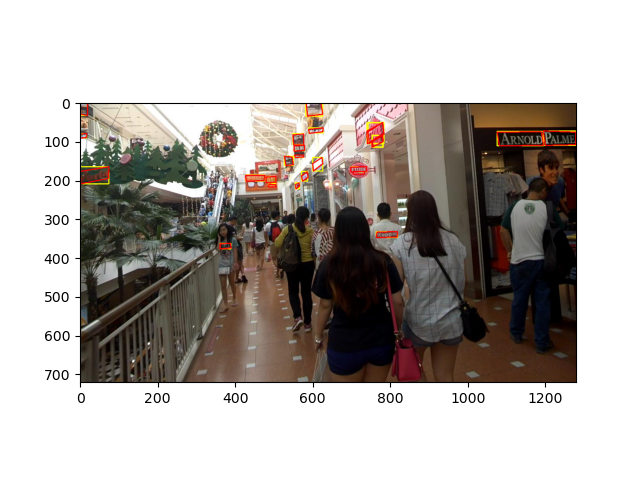

['Faces', '###', '###', '###']
tensor([[0.9141, 0.1347, 0.0812, 0.0861],
        [0.9813, 0.1236, 0.0359, 0.0667],
        [0.3539, 0.3153, 0.0156, 0.0167],
        [0.8418, 0.6229, 0.0133, 0.0708]])


<IPython.core.display.Javascript object>


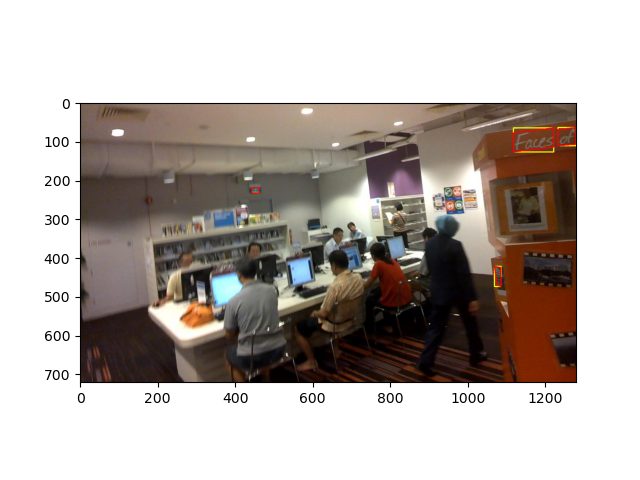

['###', '###', 'Love', 'Life', '###', 'LIVE', 'LIFE', 'riding', '###', '###', '###', '###', '###', 'PEP', '###', '###', '###', '###']
tensor([[0.4234, 0.8472, 0.0297, 0.0528],
        [0.4695, 0.8160, 0.0609, 0.0792],
        [0.1574, 0.3951, 0.0523, 0.0847],
        [0.3223, 0.1014, 0.0695, 0.0889],
        [0.3695, 0.0944, 0.0359, 0.0639],
        [0.1355, 0.2278, 0.0570, 0.0528],
        [0.1441, 0.3132, 0.0430, 0.0625],
        [0.3594, 0.1646, 0.0781, 0.0681],
        [0.4887, 0.8944, 0.0773, 0.1250],
        [0.4641, 0.8583, 0.0656, 0.0833],
        [0.1426, 0.2701, 0.0164, 0.0264],
        [0.1508, 0.3562, 0.0187, 0.0236],
        [0.4359, 0.9396, 0.0391, 0.0486],
        [0.4254, 0.9715, 0.0664, 0.0458],
        [0.4918, 0.9389, 0.0758, 0.1028],
        [0.2719, 0.5160, 0.0250, 0.0319],
        [0.3914, 0.0910, 0.0156, 0.0597],
        [0.4043, 0.1660, 0.0133, 0.0431]])


<IPython.core.display.Javascript object>


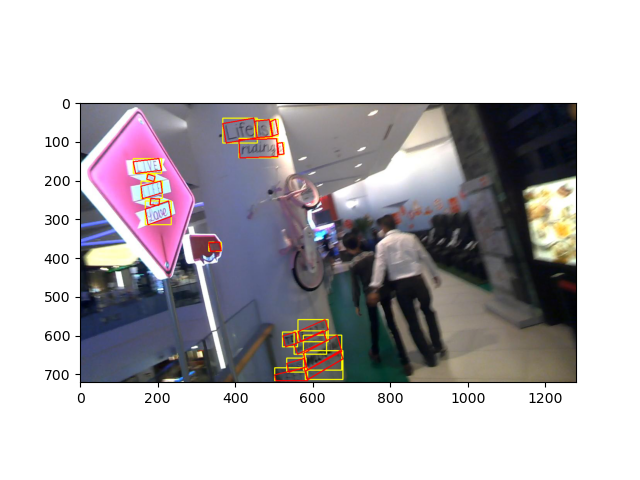

In [8]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Focused Scene Text

In [9]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     #target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARFocusedSceneTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['Guidex', 'Folders']
tensor([[0.4156, 0.8365, 0.2438, 0.0688],
        [0.6820, 0.8365, 0.2328, 0.0688]])


/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>

['Info@serviplus.de', 'www.serviplus.de', 'Geld', 'einwerfen', 'Betriebsbereit', '###']
tensor([[0.4549, 0.0625, 0.1870, 0.0355],
        [0.4500, 0.1628, 0.4416, 0.1281],
        [0.1591, 0.4796, 0.1860, 0.1003],
        [0.5055, 0.4819, 0.3999, 0.0980],
        [0.3855, 0.6026, 0.6384, 0.0988],
        [0.4572, 0.0098, 0.2153, 0.0197]])


<IPython.core.display.Javascript object>


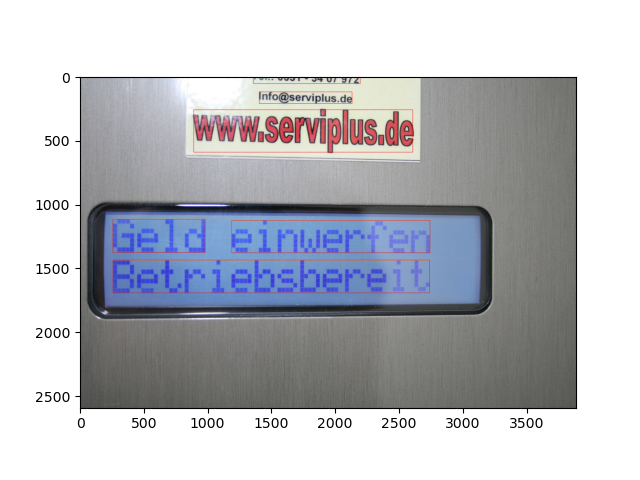

['BAE', 'SYSTEMS']
tensor([[0.2500, 0.5667, 0.1969, 0.0833],
        [0.6406, 0.5750, 0.4906, 0.0917]])


<IPython.core.display.Javascript object>


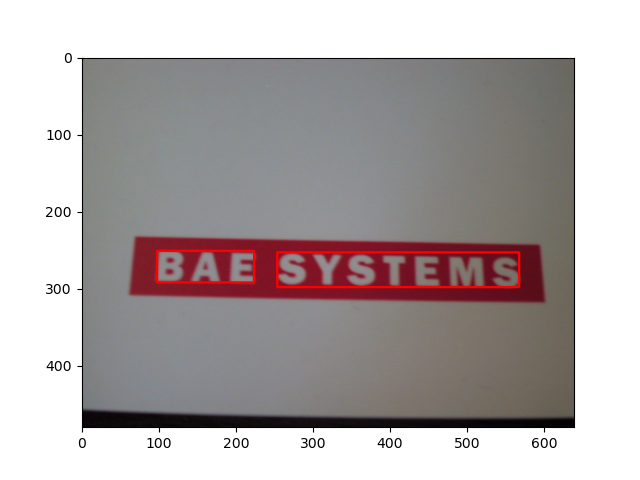

['Oleg', 'Rostanin', 'Asif', 'Shahab', '2.10']
tensor([[0.4313, 0.3542, 0.1193, 0.0910],
        [0.6155, 0.3522, 0.2109, 0.0710],
        [0.4807, 0.5127, 0.0998, 0.0718],
        [0.6352, 0.5127, 0.1803, 0.0702],
        [0.0248, 0.7417, 0.0435, 0.0258]])


<IPython.core.display.Javascript object>


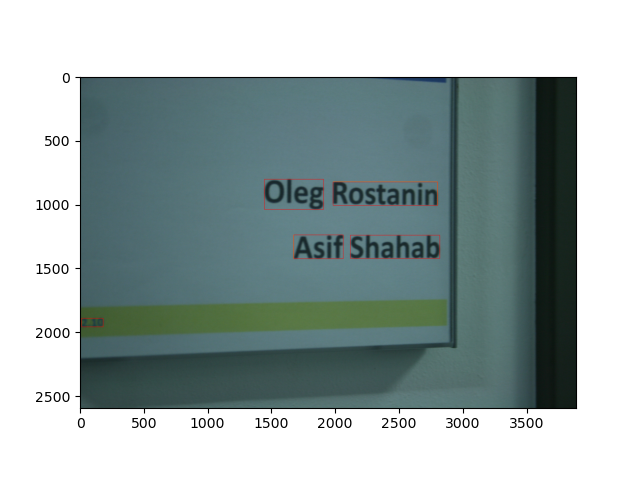

['Constantine', 'Room']
tensor([[0.4914, 0.4365, 0.7516, 0.1687],
        [0.4898, 0.6156, 0.3766, 0.1687]])


<IPython.core.display.Javascript object>


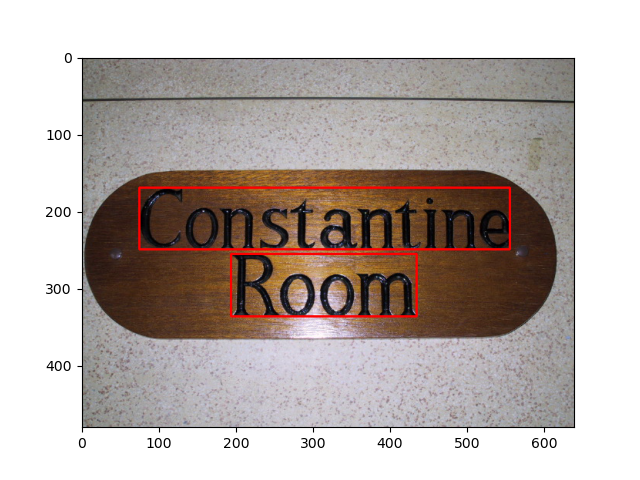

['4.513B', '###', 'Computing', 'Service', 'HELP', 'DESK']
tensor([[0.2115, 0.0539, 0.2917, 0.0609],
        [0.7885, 0.0387, 0.0542, 0.0258],
        [0.5052, 0.1813, 0.4729, 0.0609],
        [0.5031, 0.2523, 0.3312, 0.0484],
        [0.5016, 0.4773, 0.9135, 0.2688],
        [0.4927, 0.7969, 0.9583, 0.2578]])


<IPython.core.display.Javascript object>


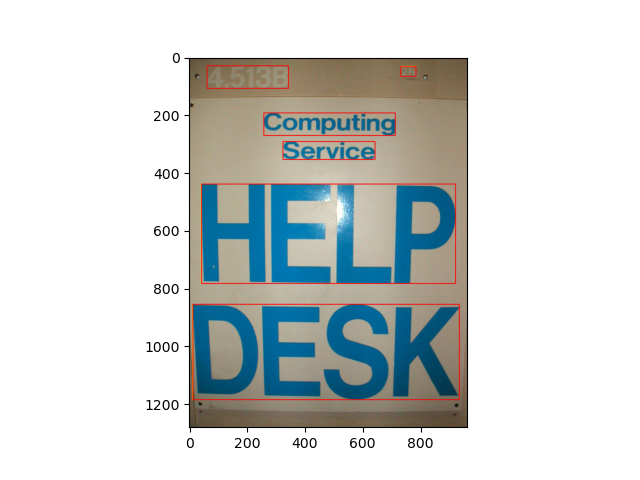

['WHSmith', 'Summer', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.4938, 0.5396, 0.9469, 0.2208],
        [0.2258, 0.9552, 0.1109, 0.0271],
        [0.2945, 0.8135, 0.0109, 0.0271],
        [0.5617, 0.9427, 0.0328, 0.0604],
        [0.7961, 0.9448, 0.0297, 0.0562],
        [0.6391, 0.8687, 0.0125, 0.0292],
        [0.8789, 0.8698, 0.0109, 0.0271],
        [0.6398, 0.8896, 0.0234, 0.0042],
        [0.7195, 0.8917, 0.0234, 0.0042],
        [0.6313, 0.9083, 0.0188, 0.0125],
        [0.7102, 0.9094, 0.0172, 0.0104],
        [0.7914, 0.9073, 0.0672, 0.0104],
        [0.3258, 0.8417, 0.0516, 0.0083],
        [0.3305, 0.8531, 0.0391, 0.0021],
        [0.3313, 0.8802, 0.0719, 0.0104],
        [0.3266, 0.9125, 0.0687, 0.0000],
        [0.3297, 0.9177, 0.0687, 0.0021],
        [0.3281, 0.9240, 0.0750, 0.0021],
        [0.2

<IPython.core.display.Javascript object>


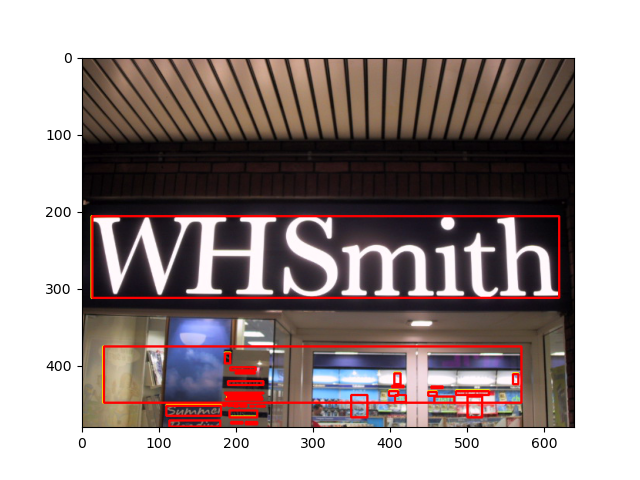

['4B.528', '4B.526', '4B.524', '4B.522', 'YOU', 'ARE', 'HERE']
tensor([[0.1207, 0.2839, 0.1367, 0.0385],
        [0.1109, 0.4729, 0.1469, 0.0437],
        [0.1129, 0.6505, 0.1367, 0.0385],
        [0.1164, 0.8214, 0.1375, 0.0448],
        [0.3910, 0.5891, 0.0898, 0.0406],
        [0.5090, 0.5911, 0.0914, 0.0385],
        [0.6426, 0.5932, 0.1211, 0.0385]])


<IPython.core.display.Javascript object>


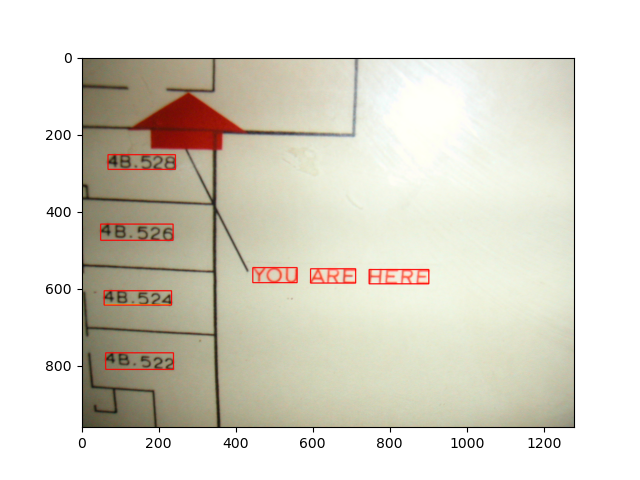

['TAXI']
tensor([[0.5070, 0.4938, 0.7172, 0.3000]])


<IPython.core.display.Javascript object>

['plan', 'art', 'V03', '###']
tensor([[0.2774, 0.7274, 0.2822, 0.2133],
        [0.5651, 0.7330, 0.1754, 0.1644],
        [0.2710, 0.2847, 0.3161, 0.1944],
        [0.6066, 0.3086, 0.1587, 0.1798]])


<IPython.core.display.Javascript object>


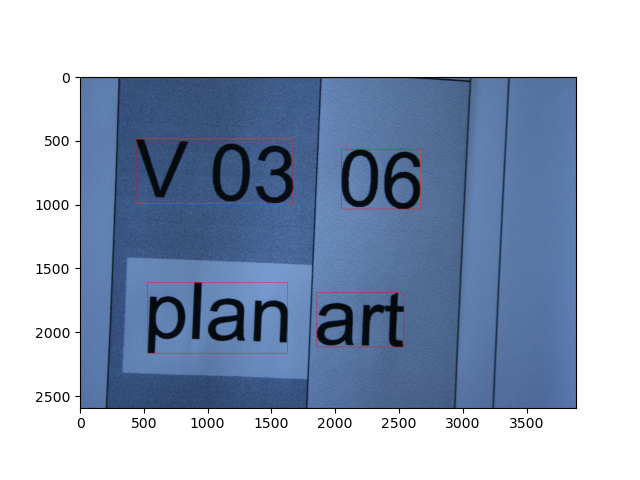

['PEDESTRIANS']
tensor([[0.4570, 0.2854, 0.6547, 0.1000]])


<IPython.core.display.Javascript object>


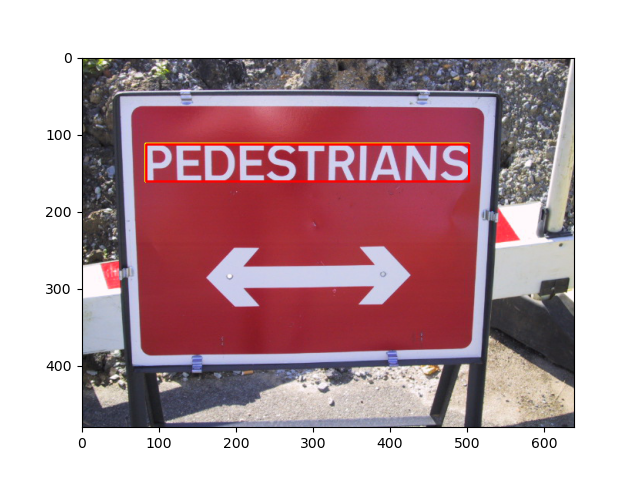

['###', 'ENTRY', 'WHEN', 'RED', 'LIGHT', '###', 'FLASHING', '###', '###', '###', '###', '###', '###', '###', '###', '###']
tensor([[0.1855, 0.3583, 0.0789, 0.0563],
        [0.3383, 0.3646, 0.1969, 0.0604],
        [0.2250, 0.4521, 0.1687, 0.0625],
        [0.3848, 0.4609, 0.1195, 0.0594],
        [0.2578, 0.5448, 0.1750, 0.0646],
        [0.3871, 0.5552, 0.0523, 0.0562],
        [0.2937, 0.6365, 0.2828, 0.0771],
        [0.5555, 0.1552, 0.0750, 0.0062],
        [0.5523, 0.2172, 0.1047, 0.1073],
        [0.8012, 0.1505, 0.0961, 0.0073],
        [0.7984, 0.1620, 0.0687, 0.0052],
        [0.5582, 0.0432, 0.1352, 0.0865],
        [0.8027, 0.0464, 0.1523, 0.0927],
        [0.7945, 0.2219, 0.1406, 0.0958],
        [0.9906, 0.2094, 0.0172, 0.1354],
        [0.9859, 0.4953, 0.0266, 0.0906]])


<IPython.core.display.Javascript object>


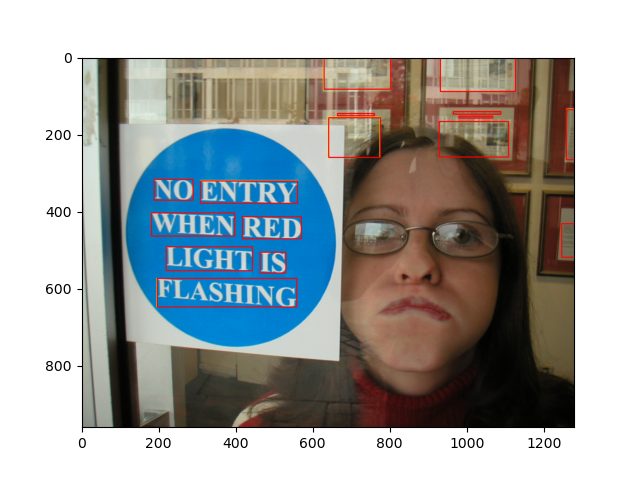

['DOLLAR', 'GLEN', 'AND', 'CASTLE', 'CAMPBELL']
tensor([[0.3453, 0.4177, 0.3938, 0.0854],
        [0.7297, 0.4156, 0.2500, 0.0854],
        [0.5031, 0.5531, 0.1594, 0.0604],
        [0.2602, 0.6854, 0.3203, 0.0833],
        [0.6938, 0.6833, 0.4344, 0.0875]])


<IPython.core.display.Javascript object>


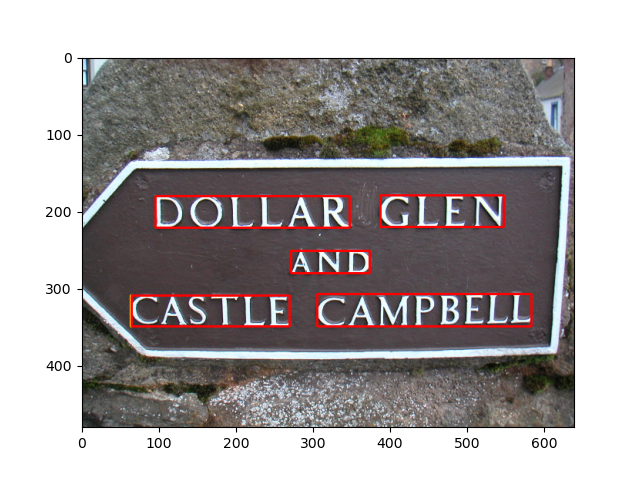

['iiyama']
tensor([[0.5102, 0.4797, 0.4906, 0.2135]])


<IPython.core.display.Javascript object>


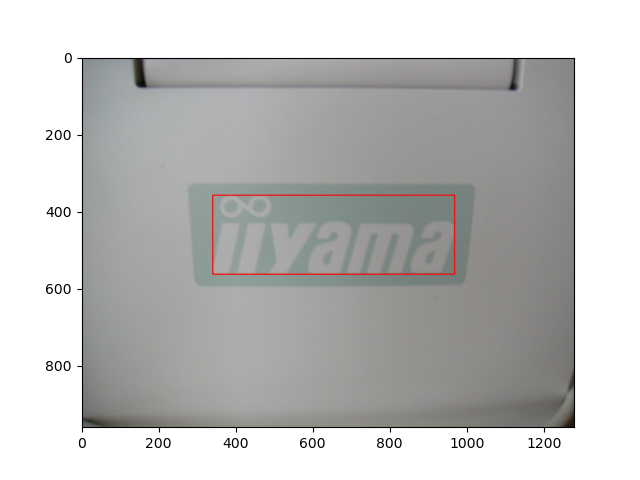

['TOYOTA']
tensor([[0.4938, 0.5365, 0.7625, 0.1771]])


<IPython.core.display.Javascript object>


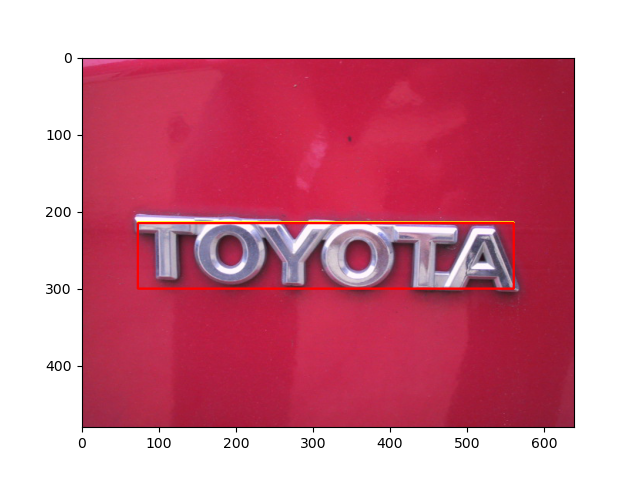

In [10]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)

# Born Digital Images

In [11]:
target_transform = target_transforms.Compose(
    [target_transforms.Corners2Centroids(),
     target_transforms.ToQuadrilateral(),
     target_transforms.ToTensor()]
)
train_dataset = datasets.ICDARBornDigitalTextDataset(ignore=None, transform=transform, target_transform=target_transform, augmentation=None)

['CADILLAC', 'BLS', 'Our', 'Goal', 'was', '###', 'create', 'the', 'finest', 'mid-size', 'performance', 'car', '###', 'the', 'European', 'market.', 'The', 'result', '###', '###', 'car', '###', 'intelligent', '###', '###', '###', 'beautiful', 'BLS', 'uses', 'cutting', '###', 'edge', 'technology', '###', 'give', 'its', 'style', 'true', 'purpose:', 'the', 'dynamic', 'driving', 'and', 'generous', 'comfort', '###', '###', 'true', 'Cadillac.', 'Visit', 'the', 'Cadillac', 'Media', 'Site', 'for', 'more', 'technical', 'information', 'about', 'our', 'products.', 'CONTACT']
tensor([[0.0721, 0.7618, 0.0776, 0.0270],
        [0.1336, 0.7618, 0.0272, 0.0270],
        [0.0650, 0.8083, 0.0151, 0.0152],
        [0.0862, 0.8100, 0.0171, 0.0186],
        [0.1084, 0.8108, 0.0171, 0.0101],
        [0.1250, 0.8083, 0.0081, 0.0152],
        [0.1472, 0.8083, 0.0282, 0.0152],
        [0.1714, 0.8083, 0.0141, 0.0152],
        [0.1946, 0.8083, 0.0262, 0.0152],
        [0.2314, 0.8083, 0.0393, 0.0152],
        [0.

/home/kado/.pyenv/versions/anaconda3-2019.07/envs/dl/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  del sys.path[0]


<IPython.core.display.Javascript object>


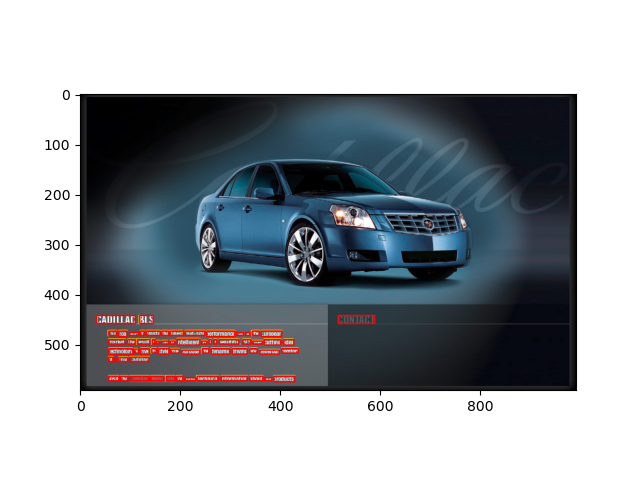

['FREE', 'SPIRIT']
tensor([[0.4872, 0.2585, 0.4359, 0.0932],
        [0.4872, 0.7331, 0.4359, 0.1102]])


<IPython.core.display.Javascript object>


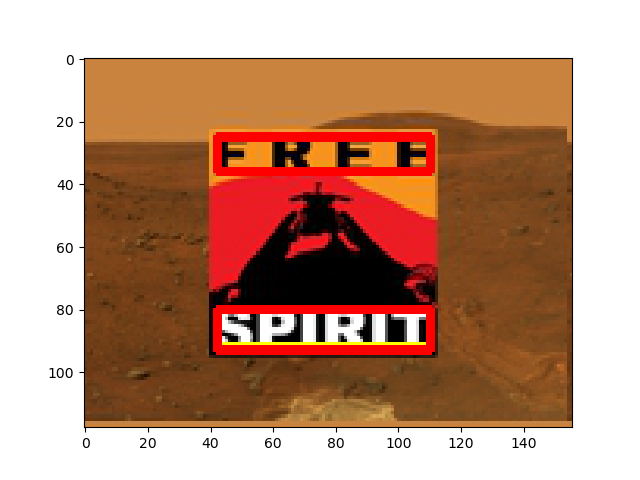

['###', 'bookings', '###', 'booking', 'Frequent', 'flyer', 'card', 'Seat', 'Special', 'meals', 'Visa/APIS', 'data', 'Cancellation']
tensor([[0.0925, 0.0764, 0.1027, 0.0417],
        [0.3425, 0.0764, 0.3425, 0.0417],
        [0.2123, 0.4931, 0.0822, 0.0417],
        [0.4075, 0.4931, 0.2397, 0.0417],
        [0.3116, 0.5764, 0.2808, 0.0417],
        [0.5548, 0.5764, 0.1370, 0.0417],
        [0.7260, 0.5718, 0.1370, 0.0324],
        [0.2397, 0.6551, 0.1370, 0.0324],
        [0.2842, 0.7431, 0.2260, 0.0417],
        [0.5205, 0.7384, 0.1781, 0.0324],
        [0.3288, 0.8218, 0.3151, 0.0324],
        [0.5856, 0.8218, 0.1301, 0.0324],
        [0.3630, 0.9051, 0.3836, 0.0324]])


<IPython.core.display.Javascript object>


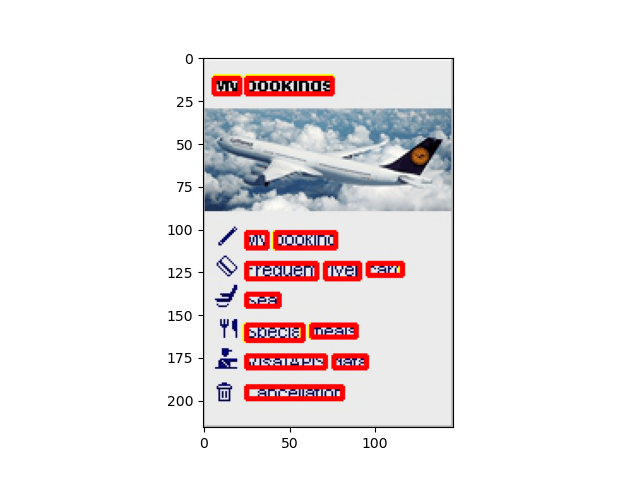

['RAVENS', 'CALL', 'E-NEWS', 'UPDATES']
tensor([[0.4255, 0.2177, 0.3742, 0.1129],
        [0.7566, 0.2097, 0.2417, 0.0968],
        [0.4255, 0.3589, 0.1821, 0.1048],
        [0.6424, 0.3589, 0.2119, 0.1048]])


<IPython.core.display.Javascript object>


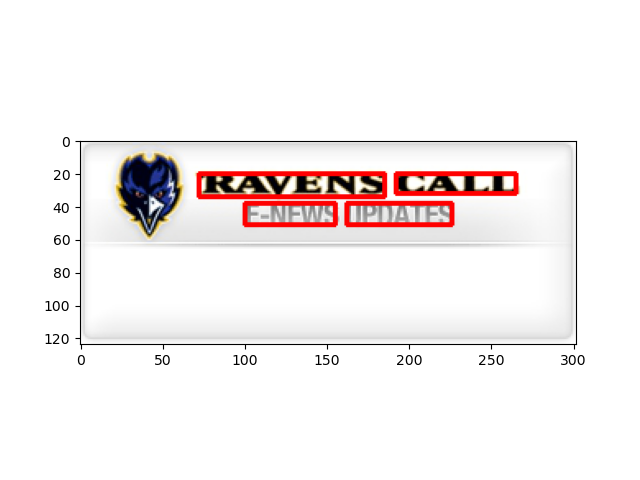

['###', 'ARE', 'YOUR', 'OFF-SITE', 'FORTUNE', '500', '###', 'DEPARTMENT.', 'LEARN', 'MORE', '###']
tensor([[0.0733, 0.0902, 0.0745, 0.0677],
        [0.1791, 0.0902, 0.0938, 0.0677],
        [0.3137, 0.0883, 0.1322, 0.0714],
        [0.1526, 0.2068, 0.2236, 0.0677],
        [0.3978, 0.2068, 0.2332, 0.0677],
        [0.5745, 0.2068, 0.0865, 0.0677],
        [0.1298, 0.3365, 0.0433, 0.0789],
        [0.3774, 0.3365, 0.3942, 0.0789],
        [0.8077, 0.9060, 0.0625, 0.0301],
        [0.8822, 0.9060, 0.0577, 0.0301],
        [0.9315, 0.9060, 0.0168, 0.0376]])


<IPython.core.display.Javascript object>


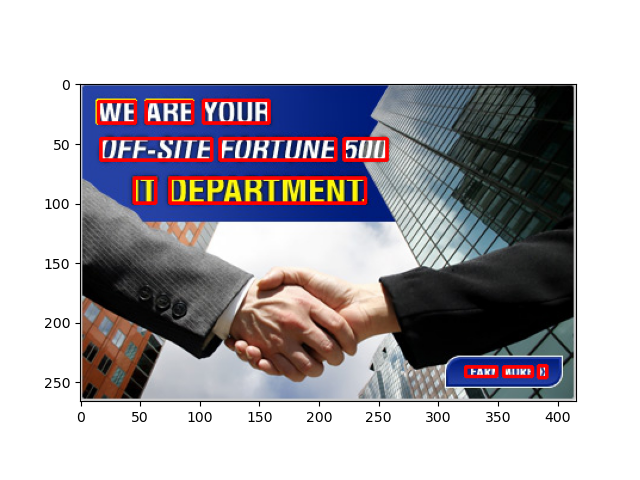

['Must', 'Go!', 'Falcon', 'Hopper', 'Unisex', 'Bike', '###', 'White', '12"', 'Was', '£57.97', 'NOW', '£28.99', '50%', 'Off']
tensor([[0.6795, 0.1233, 0.1227, 0.0933],
        [0.7977, 0.2067, 0.0955, 0.0667],
        [0.2045, 0.6883, 0.1727, 0.0300],
        [0.4159, 0.6933, 0.1864, 0.0400],
        [0.6364, 0.6883, 0.1727, 0.0300],
        [0.1727, 0.7450, 0.1091, 0.0300],
        [0.2636, 0.7500, 0.0091, 0.0000],
        [0.3773, 0.7450, 0.1636, 0.0300],
        [0.5273, 0.7450, 0.0727, 0.0300],
        [0.1659, 0.8383, 0.1045, 0.0300],
        [0.3409, 0.8383, 0.1818, 0.0300],
        [0.2023, 0.9033, 0.1682, 0.0400],
        [0.4364, 0.9033, 0.2273, 0.0400],
        [0.7182, 0.8517, 0.0727, 0.0233],
        [0.8091, 0.8517, 0.0636, 0.0233]])


<IPython.core.display.Javascript object>

['Boots', 'advantage', 'card', 'time', '###', 'treat', 'yourself', 'Advantage', 'Card', 'Collect', '###', 'points', 'per', '###', 'Click', 'here', '###', 'sign', '###', 'today']
tensor([[0.4706, 0.2676, 0.2941, 0.1471],
        [0.3971, 0.4735, 0.3706, 0.0765],
        [0.6824, 0.4647, 0.1412, 0.0588],
        [0.3000, 0.5471, 0.1059, 0.0353],
        [0.3853, 0.5500, 0.0412, 0.0294],
        [0.4794, 0.5500, 0.1118, 0.0294],
        [0.6353, 0.5500, 0.1765, 0.0412],
        [0.2912, 0.7500, 0.5118, 0.1000],
        [0.6941, 0.7382, 0.2118, 0.0765],
        [0.1324, 0.8441, 0.1941, 0.0529],
        [0.2676, 0.8471, 0.0294, 0.0471],
        [0.4000, 0.8559, 0.1647, 0.0647],
        [0.5618, 0.8618, 0.0882, 0.0529],
        [0.6559, 0.8471, 0.0529, 0.0471],
        [0.1000, 0.9265, 0.1294, 0.0529],
        [0.2559, 0.9265, 0.1235, 0.0529],
        [0.3706, 0.9294, 0.0471, 0.0471],
        [0.4794, 0.9382, 0.1118, 0.0647],
        [0.6029, 0.9441, 0.0647, 0.0529],
        [0.7441, 0.9353,

<IPython.core.display.Javascript object>

['Thomas', 'Cook', 'Sport', 'ARSENAL', 'MATCH', 'BREAKS', 'MATCH', 'TICKET', '###', 'FROM', 'ONLY', '£119*', 'CLICK', 'HERE', '*Terms', '###', 'conditions', 'apply']
tensor([[0.2417, 0.0225, 0.4333, 0.0183],
        [0.6250, 0.0225, 0.2667, 0.0183],
        [0.1417, 0.0450, 0.2333, 0.0167],
        [0.5000, 0.1650, 0.9333, 0.0333],
        [0.4958, 0.2100, 0.7083, 0.0333],
        [0.5042, 0.2533, 0.8083, 0.0333],
        [0.4250, 0.3650, 0.3833, 0.0167],
        [0.3500, 0.3917, 0.4000, 0.0167],
        [0.6583, 0.3917, 0.1167, 0.0167],
        [0.3125, 0.5992, 0.3750, 0.0217],
        [0.7417, 0.5992, 0.3500, 0.0217],
        [0.5167, 0.6467, 0.7500, 0.0433],
        [0.3625, 0.9400, 0.2250, 0.0133],
        [0.6125, 0.9400, 0.2083, 0.0100],
        [0.1583, 0.9883, 0.2500, 0.0133],
        [0.3333, 0.9883, 0.0667, 0.0133],
        [0.5583, 0.9867, 0.3500, 0.0133],
        [0.8500, 0.9892, 0.1833, 0.0183]])


<IPython.core.display.Javascript object>


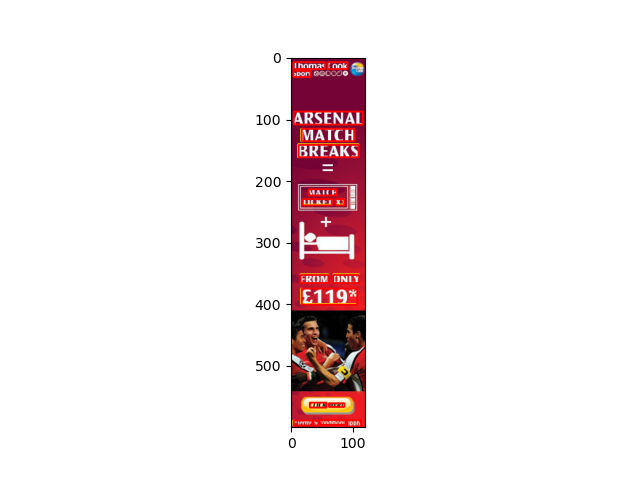

['Lotus', 'knows:', 'collaborate', '###', 'the', 'cloud', 'Learn', 'more']
tensor([[0.1517, 0.2120, 0.1910, 0.0880],
        [0.4129, 0.2120, 0.2528, 0.0880],
        [0.2528, 0.3560, 0.4045, 0.0880],
        [0.0787, 0.5000, 0.0449, 0.0880],
        [0.1910, 0.5000, 0.1124, 0.0880],
        [0.3764, 0.5000, 0.1910, 0.0880],
        [0.1910, 0.6920, 0.1461, 0.0560],
        [0.3539, 0.7000, 0.1236, 0.0400]])


<IPython.core.display.Javascript object>


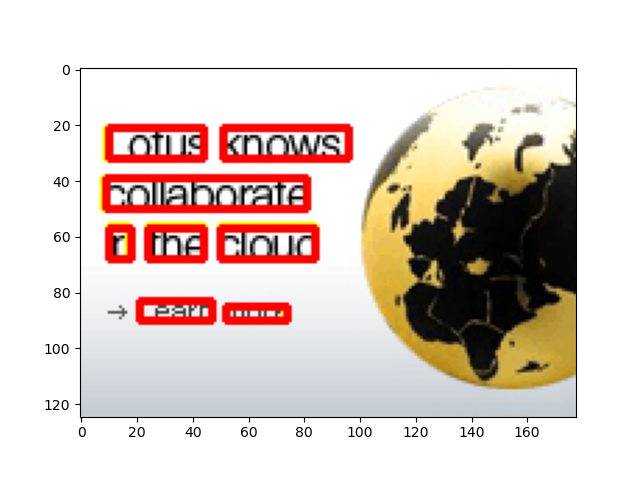

['Education', '###', 'Find', 'out', 'more', 'about', 'studying', '###', 'the', '###']
tensor([[0.4322, 0.2524, 0.5829, 0.2000],
        [0.8417, 0.2810, 0.1558, 0.2952],
        [0.2563, 0.4857, 0.1005, 0.0762],
        [0.3693, 0.4905, 0.0754, 0.0667],
        [0.4950, 0.4952, 0.1256, 0.0571],
        [0.6482, 0.4857, 0.1407, 0.0762],
        [0.3668, 0.6143, 0.2111, 0.1048],
        [0.5176, 0.6000, 0.0302, 0.0762],
        [0.5955, 0.6095, 0.0754, 0.0762],
        [0.6910, 0.6095, 0.0653, 0.0762]])


<IPython.core.display.Javascript object>


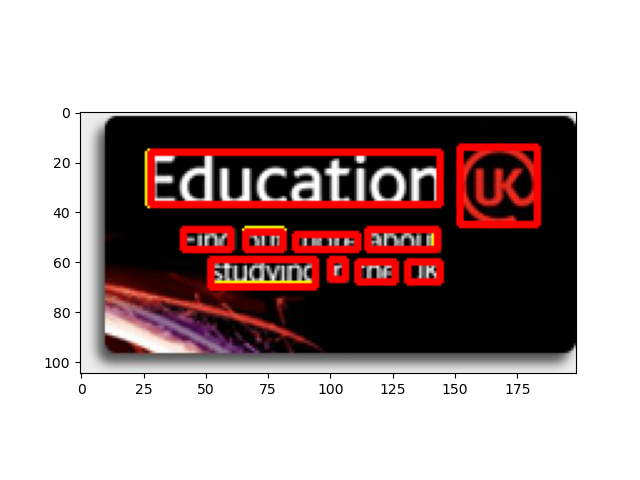

['Next', 'Match']
tensor([[0.1514, 0.0840, 0.1673, 0.1221],
        [0.3665, 0.0802, 0.2231, 0.1298]])


<IPython.core.display.Javascript object>


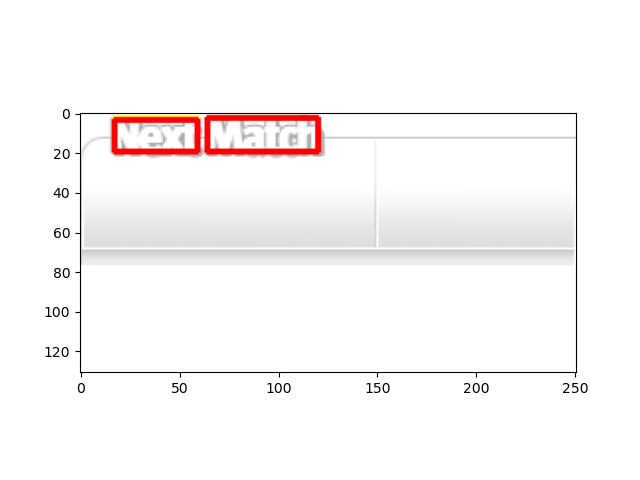

['Stratford', '###', 'upon', '###', 'Avon', '...a', 'delightful', 'surprise', '###', 'the', 'heart', '###', 'England']
tensor([[0.2168, 0.3783, 0.3190, 0.3043],
        [0.3970, 0.4174, 0.0233, 0.0348],
        [0.5072, 0.4565, 0.1792, 0.3043],
        [0.6174, 0.4174, 0.0233, 0.0348],
        [0.7258, 0.3783, 0.1864, 0.3043],
        [0.3100, 0.7304, 0.0394, 0.0696],
        [0.4104, 0.7217, 0.1362, 0.1565],
        [0.5457, 0.7304, 0.1165, 0.1391],
        [0.6281, 0.7130, 0.0233, 0.1043],
        [0.6729, 0.7087, 0.0412, 0.1130],
        [0.7410, 0.7087, 0.0735, 0.1130],
        [0.8047, 0.7217, 0.0323, 0.1565],
        [0.8862, 0.7217, 0.1237, 0.1565]])


<IPython.core.display.Javascript object>


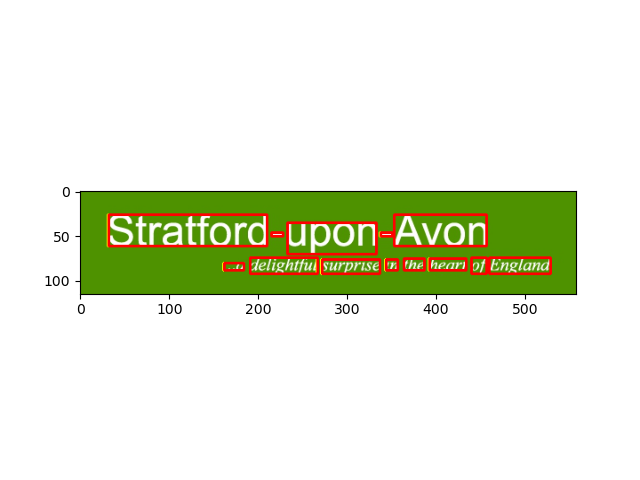

['ASTRA', 'Introducing', 'the', 'All', 'New', 'Vauxhall', 'Astra', 'Find', 'out', 'more']
tensor([[0.4921, 0.5248, 0.9524, 0.2979],
        [0.1587, 0.7801, 0.2751, 0.0709],
        [0.3571, 0.7766, 0.0794, 0.0496],
        [0.4444, 0.7730, 0.0635, 0.0567],
        [0.5529, 0.7730, 0.1111, 0.0567],
        [0.7222, 0.7766, 0.2063, 0.0496],
        [0.9101, 0.7766, 0.1270, 0.0496],
        [0.1508, 0.9043, 0.0899, 0.0496],
        [0.2540, 0.9078, 0.0635, 0.0426],
        [0.3704, 0.9113, 0.1164, 0.0355]])


<IPython.core.display.Javascript object>


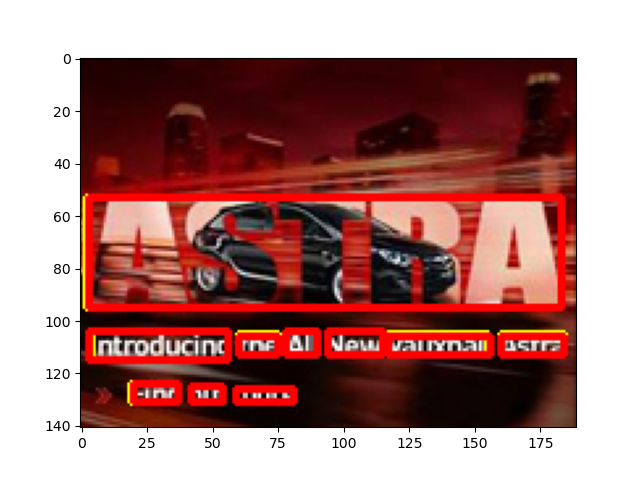

['JANUARY', 'SALE', 'NOW', 'ON!', 'CLICK', 'HERE', 'FOR', 'HUGE', 'SAVINGS']
tensor([[0.2663, 0.1847, 0.4096, 0.3439],
        [0.2663, 0.6178, 0.4942, 0.6115],
        [0.7740, 0.1497, 0.1404, 0.2866],
        [0.9077, 0.2994, 0.1154, 0.2803],
        [0.6990, 0.5223, 0.1212, 0.1656],
        [0.8269, 0.5828, 0.1115, 0.1592],
        [0.5942, 0.6783, 0.0808, 0.1465],
        [0.7019, 0.7229, 0.1115, 0.1592],
        [0.8606, 0.7962, 0.1827, 0.1911]])


<IPython.core.display.Javascript object>


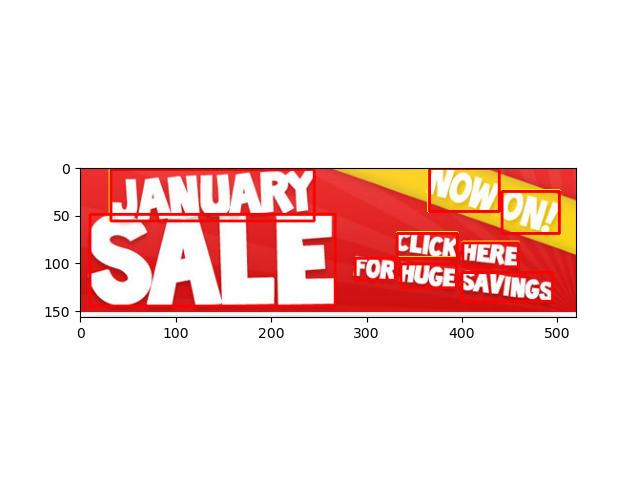

['THE', 'BEST', '###', 'REM']
tensor([[0.1045, 0.1091, 0.1364, 0.0545],
        [0.3000, 0.1091, 0.1818, 0.0545],
        [0.4727, 0.1091, 0.0727, 0.0545],
        [0.6545, 0.1000, 0.1818, 0.0727]])


<IPython.core.display.Javascript object>


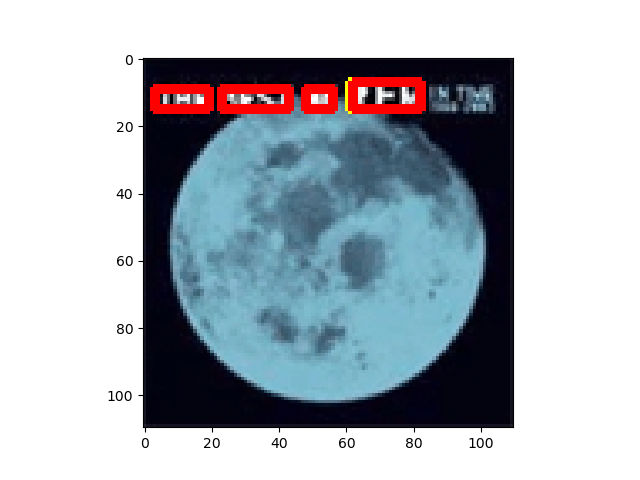

In [12]:
indices = np.random.randint(0, len(train_dataset), 15)

for index in indices:
    img, targets, texts = train_dataset[index]
    
    locs, quads = targets[:, :4], targets[:, 4:12]
    
    print(texts)
    print(locs)
    img = toVisualizeRectRGBimg(img, locs, rgb=(255,255,0), verbose=False)# yellow
    img = toVisualizeQuadsRGBimg(torch.from_numpy(img.transpose((2, 0, 1)) / 255.), quads, verbose=False)# red

    plt.figure()
    plt.imshow(img)